In [1]:
#!pip install einops

In [2]:
!pip install torchvision --upgrade

     |████████████████████████████████| 24.3 MB 544 kB/s eta 0:00:01
     |████████████████████████████████| 890.2 MB 4.7 kB/s  eta 0:00:01    |▋                               | 16.0 MB 53.2 MB/s eta 0:00:17     |▉                               | 22.1 MB 1.2 MB/s eta 0:12:27     |█                               | 25.9 MB 1.2 MB/s eta 0:12:24     |██▎                             | 63.6 MB 883 kB/s eta 0:15:36     |██▌                             | 69.9 MB 1.2 MB/s eta 0:11:37     |█████████▏                      | 255.1 MB 1.2 MB/s eta 0:08:29     |████████████████████▎           | 564.8 MB 1.6 MB/s eta 0:03:20     |████████████████████▋           | 572.4 MB 1.6 MB/s eta 0:03:16     |████████████████████▋           | 573.9 MB 1.6 MB/s eta 0:03:15     |████████████████████▉           | 579.0 MB 1.6 MB/s eta 0:03:12     |██████████████████████▎         | 618.9 MB 27.7 MB/s eta 0:00:10     |██████████████████████▍         | 621.5 MB 27.7 MB/s eta 0:00:10     |███████████████████████       

In [4]:
import cv2
import os
import math
from collections import Counter
import numpy as np
import pandas as pd
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T
from torch.nn import Transformer
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.models as models
from torch import Tensor
from PIL import Image
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
torch.manual_seed(442)

In [5]:
class Vocabulary:
    #tokenizer
    spacy_eng = spacy.load("en_core_web_sm")

    
    def __init__(self,freq_threshold):
        #setting the pre-reserved tokens int to string tokens
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        
        #string to int tokens
        #its reverse dict self.itos
        self.stoi = {v:k for k,v in self.itos.items()}
        
        self.freq_threshold = freq_threshold
        
        
        
    def __len__(self): return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in Vocabulary.spacy_eng.tokenizer(text)]
    
    def build_vocab(self, sentence_list):
        frequencies = Counter()
        
        #staring index 4
        idx = 4
        
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                #add the word to the vocab if it reaches minum frequecy threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        """ For each word in the text corresponding index token for that word form the vocab built as list """
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]    
UNK_IDX, PAD_IDX, BOS_IDX, EOS_IDX= 3,0,1,2

In [6]:
image_path = "../input/ucm-dataset/UCMDATA/imgs/"
dir_text = "../input/ucm-dataset/UCMDATA/filenames/descriptions_UCM.txt"
train_imgs_txt_path="../input/ucm-dataset/UCMDATA/filenames/filenames_train.txt"
val_imgs_txt_path="../input/ucm-dataset/UCMDATA/filenames/filenames_val.txt"
test_imgs_txt_path="../input/ucm-dataset/UCMDATA/filenames/filenames_test.txt"
jpgs = os.listdir(image_path)
print("Total Images in Dataset = {}".format(len(jpgs)))

Total Images in Dataset = 2100


In [7]:
file = open(dir_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
    col = line.split(' ')
    filenumber=col[0]
    caption=' '.join(col[1:])
    img=filenumber+'.tif'
    datatxt.append([filenumber]+[img]+[caption])
data = pd.DataFrame(datatxt,columns=["img_number","img","caption"])

uni_filenames = np.unique(data.img.values)
data.head(10)

,img_number,img,caption
0,1,1.tif,there is a piece of farmland
1,1,1.tif,there is a piece of cropland
2,1,1.tif,it is a piece of farmland
3,1,1.tif,it is a piece of cropland
4,1,1.tif,here is a piece of farmland
5,2,2.tif,there is a piece of farmland
6,2,2.tif,there is a piece of cropland
7,2,2.tif,it is a piece of farmland
8,2,2.tif,it is a piece of cropland
9,2,2.tif,here is a piece of farmland


In [8]:
train_imgs_number_vector=[]
file = open(train_imgs_txt_path,'r')
text = file.read()
file.close()
for line in text.split('\n'):
    col = line.split('.')
    filenumber=col[0]
    train_imgs_number_vector.append(filenumber)
train_captions = []
train_nb=[]
for nb in train_imgs_number_vector:
    train_data=data[data["img_number"]==nb]
    for caption  in train_data["caption"].astype(str):
        train_captions.append(caption)
        train_nb.append(nb)

In [9]:
test_imgs_number_vector=[]
file = open(test_imgs_txt_path,'r')
text = file.read()
file.close()
for line in text.split('\n'):
    col = line.split('.')
    filenumber=col[0]
    test_imgs_number_vector.append(filenumber)
test_captions = []
test_dict={}
for nb in test_imgs_number_vector:
    test_data=data[data["img_number"]==nb]
    for caption  in test_data["caption"].astype(str):
        l_capt=caption.split()
        if nb in test_dict.keys():
            test_dict[nb].append(l_capt)
        else:
            test_dict[nb]=[l_capt]

In [10]:
val_imgs_number_vector=[]
file = open(val_imgs_txt_path,'r')
text = file.read()
file.close()
for line in text.split('\n'):
    col = line.split('.')
    filenumber=col[0]
    val_imgs_number_vector.append(filenumber)
val_dict={}
for nb in val_imgs_number_vector:
    val_data=data[data["img_number"]==nb]
    for caption  in val_data["caption"].astype(str):
        l_capt=caption.split()
        if nb in val_dict.keys():
            val_dict[nb].append(l_capt)
        else:
            val_dict[nb]=[l_capt]
val_captions = []
val_nb=[]
for nb in val_imgs_number_vector:
    val_data=data[data["img_number"]==nb]
    for caption  in val_data["caption"].astype(str):
        val_captions.append(caption)
        val_nb.append(nb)

In [11]:
freq_threshold=1
vocab= Vocabulary(freq_threshold)
vocab.build_vocab(train_captions+val_captions)
len(vocab)

333

In [12]:
def Patch_extract(img_nb):
    imga_locationa =image_path+img_nb+'.tif'
    imga = cv2.imread(imga_locationa)
    imga = cv2.cvtColor(imga, cv2.COLOR_BGR2RGB)
    transf=T.Compose([T.ToTensor(),T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),T.Resize(224)])
    imga=transf(imga)
    return imga  

In [13]:
class BuildingChangedataset(Dataset):
    """
    FlickrDataset
    """
    def __init__(self,train_nb,train_captions,vocab,transform=None):
        self.transform = transform
        #Get image and caption colum from the dataframe
        self.imgs = train_nb
        self.captions = train_captions
        self.p=Patch_size
        #Initialize vocabulary and build vocab
        self.vocab = vocab
        
    
    def __len__(self):
        return len(self.imgs)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_nb = self.imgs[idx]
        
        imga_locationa =image_path+img_nb+'.tif'
        imga = cv2.imread(imga_locationa)
        imga = cv2.cvtColor(imga, cv2.COLOR_BGR2RGB)
        #apply the transfromation to the image
        if self.transform is not None:
            imga = self.transform(imga)
        
        #numericalize the caption text
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        transf=T.Compose([T.ToTensor(),T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),T.Resize(224)])
        imga=transf(imga)
        return img_nb,imga,torch.tensor(caption_vec)    
    
class CapsCollate:
    """
    Collate to apply the padding to the captions with dataloader
    """
    def __init__(self,pad_idx,batch_first=False):
        self.batch_first = batch_first
    
    def __call__(self,batch):
        img_batch,cap_batch=[],[]
        for img_nb,img,cap in batch:
            img_batch.append(img)
            cap_batch.append(cap)
        cap_batch=pad_sequence(cap_batch, padding_value=PAD_IDX)
        img_batch=pad_sequence(img_batch,padding_value=PAD_IDX)
        return img_nb,img_batch,cap_batch


def get_data_loader(dataset,batch_size,shuffle=False,num_workers=1):

    pad_idx = dataset.vocab.stoi["<PAD>"]
    collate_fn = CapsCollate(pad_idx=pad_idx,batch_first=True)

    data_loader = DataLoader(
        dataset=dataset,
        batch_size=batch_size,
        shuffle=shuffle,
        num_workers=num_workers,
        collate_fn=collate_fn
    )

    return data_loader


In [14]:
class EncoderCNN(nn.Module):
    def __init__(self,emb_size):
        super(EncoderCNN, self).__init__()
        resnet = models.resnet101(pretrained=True)
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)
        for param in self.resnet.parameters():
            param.requires_grad_(True)
        self.conv=nn.Conv2d(2048,emb_size,1)
    def forward(self, images):
        images=images.permute(1,0,2,3)
        features = self.resnet(images) #(batch_size,2048,7,7)
        features= self.conv(features)
        features = features.permute(0, 2, 3, 1)                           #(batch_size,7,7,2048)
        features = features.view(features.size(0), -1, features.size(-1))
        features = features.permute(1,0,2) 
        return features

In [15]:
from torch import Tensor
import torch
import torch.nn as nn
from torch.nn import Transformer
import math
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
class PositionalEncoding(nn.Module):
    def __init__(self,
                 emb_size: int,
                 dropout: float,
                 maxlen: int = 5000):
        super(PositionalEncoding, self).__init__()
        den = torch.exp(- torch.arange(0, emb_size, 2)* math.log(10000) / emb_size)
        pos = torch.arange(0, maxlen).reshape(maxlen, 1)
        pos_embedding = torch.zeros((maxlen, emb_size))
        pos_embedding[:, 0::2] = torch.sin(pos * den)
        pos_embedding[:, 1::2] = torch.cos(pos * den)
        pos_embedding = pos_embedding.unsqueeze(-2)

        self.dropout = nn.Dropout(dropout)
        self.register_buffer('pos_embedding', pos_embedding)
    def forward(self, token_embedding: Tensor):
        return self.dropout(token_embedding + self.pos_embedding[:token_embedding.size(0), :])
class TokenEmbedding(nn.Module):
    def __init__(self, vocab_size: int, emb_size):
        super(TokenEmbedding, self).__init__()
        self.embedding = nn.Embedding(vocab_size, emb_size)
        self.emb_size = emb_size

    def forward(self, tokens: Tensor):
        tok=tokens.permute(1,0)
        tok=self.embedding(tok.long()) * math.sqrt(self.emb_size)
        tok=tok.permute(1,0,2)
        return tok
class Seq2SeqTransformer(nn.Module):
    def __init__(self,
                 num_encoder_layers: int,
                 num_decoder_layers: int,
                 emb_size: int,
                 nhead: int,
                 patch_size: int,
                 tgt_vocab_size: int,
                 dim_feedforward: int = 512,
                 dropout: float = 0.0):
        super(Seq2SeqTransformer, self).__init__()
        self.encoder_cnn=EncoderCNN(emb_size)
        decoder_layer= nn.TransformerDecoderLayer(emb_size, nhead,dim_feedforward,dropout,"gelu")
        self.decoder=nn.TransformerDecoder(decoder_layer, num_decoder_layers, norm=None)
        self.generator = nn.Linear(emb_size, tgt_vocab_size)
        self.src_tok_emb = nn.Linear(patch_size*patch_size*3,emb_size)
        self.tgt_tok_emb = TokenEmbedding(tgt_vocab_size, emb_size)
        self.positional_encoding = PositionalEncoding(
            emb_size, dropout=dropout)

    def forward(self,
                src: Tensor,
                trg: Tensor,
                src_mask: Tensor,
                tgt_mask: Tensor,
                src_padding_mask: Tensor,
                tgt_padding_mask: Tensor,
                memory_key_padding_mask: Tensor):
        src_emb=self.encoder_cnn(src)
        tgt_emb = self.positional_encoding(self.tgt_tok_emb(trg))
        outs=self.decoder(tgt_emb,src_emb,tgt_mask)
        outs=self.generator(outs)
        return outs

    def encode(self, src: Tensor, src_mask: Tensor):
        return self.encoder_cnn(src)

    def decode(self, tgt: Tensor, memory: Tensor, tgt_mask: Tensor):
        tgt_emb = self.positional_encoding(self.tgt_tok_emb(tgt))
        return self.decoder(tgt_emb,memory)

In [16]:
def generate_square_subsequent_mask(sz):
    mask = (torch.triu(torch.ones((sz, sz), device=DEVICE)) == 1).transpose(0, 1)
    mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
    return mask


def create_mask(src, tgt):
    src_seq_len = src.shape[0]
    tgt_seq_len = tgt.shape[0]

    tgt_mask = generate_square_subsequent_mask(tgt_seq_len)
    src_mask = torch.zeros((src_seq_len, src_seq_len),device=DEVICE).type(torch.bool)

    src_padding_mask = (src == PAD_IDX).transpose(0, 1)
    tgt_padding_mask = (tgt == PAD_IDX).transpose(0, 1)
    return src_mask, tgt_mask, src_padding_mask, tgt_padding_mask

In [17]:
def beam_search(model, src, src_mask, max_len, start_symbol,k):
    model.eval()
    src = src.to(DEVICE)
    src_mask = src_mask

    memory = model.encode(src, src_mask)
    ys = torch.ones(1, 1).fill_(start_symbol).type(torch.long).to(DEVICE)
    for i in range(max_len-1):
        memory = memory.to(DEVICE)
        if (i==0):
            new_ys=[]
            new_probas=[]
            tgt_mask = (generate_square_subsequent_mask(ys.size(0)).type(torch.bool)).to(DEVICE)
            out = model.decode(ys, memory, tgt_mask)
            out = out.transpose(0, 1)
            prob = model.generator(out[:, -1])
            proba=nn.Softmax(dim=1)
            prob=proba(prob)
            p_words, words = torch.topk(prob,k)
            for word in words[0].tolist():
                new_ys.append(torch.cat([ys,torch.ones(1, 1).type_as(src.data).fill_(word)], dim=0))
            for word_proba in p_words[0]:
                new_probas.append( torch.log(word_proba ) )
        else:
            new_ys,new_probas=decode_next(model,memory,src,k,new_probas,new_ys)
        c = 0
        for y in new_ys:
            if( y.tolist()[-1][0] == EOS_IDX):
                c=c+1
        if (c==k):
            return new_ys,new_probas
    return new_ys,new_probas
        
def decode_next(model,memory,src,k,probas,word_seqs):
    new_word_seqs,new_seq_probas=[],[]
    normalized_seq_probas=[]
    for i in range(k):
        past_proba=probas[i]
        past_word_seq=word_seqs[i]
        if ( past_word_seq.tolist()[-1][0] == EOS_IDX ):
            new_seq_probas.append(past_proba)
            new_word_seqs.append(past_word_seq)
        else :
            tgt_mask = (generate_square_subsequent_mask(past_word_seq.size(0))
                        .type(torch.bool)).to(DEVICE)
            out = model.decode(past_word_seq, memory, tgt_mask)
            out = out.transpose(0, 1)
            scores = model.generator(out[:, -1])
            to_proba=nn.Softmax(dim=1)
            proba=to_proba(scores)
            words_proba, words = torch.topk(proba,k,dim=1)
            for word in words[0].tolist():
                seq=torch.cat([past_word_seq,torch.ones(1, 1).type_as(src.data).fill_(word).to(DEVICE)], dim=0)
                new_word_seqs.append(seq)
            for word_proba in words_proba[0]:
                seq_proba=torch.log(word_proba)+past_proba
                new_seq_probas.append(seq_proba)
    new_seq_probas=torch.tensor(new_seq_probas)
    for j in range(len(new_word_seqs)):
        normalized_seq_probas.append( new_seq_probas[j]/(len(new_word_seqs[j])) )
    _,indexes=torch.topk(torch.tensor(normalized_seq_probas),k,dim=0)
    topk_seq,topk_probas=[],[]
    for idx in indexes:
        topk_seq.append(new_word_seqs[idx])
        topk_probas.append(new_seq_probas[idx])
    return topk_seq,topk_probas
def translate_beam(model: torch.nn.Module, nb):
    model.eval()
    src=(torch.FloatTensor(Patch_extract(nb))).unsqueeze(1)
    src_mask = None
    topk_seq,topk_probas = beam_search(transformer, src, None,40, BOS_IDX,3)
    top_seq=topk_seq[0].flatten()
    caption_predicted=[vocab.itos[token] for token in top_seq.tolist()]
    caption_predicted=" ".join(caption_predicted).replace("<SOS>", "").replace("<EOS>", "")
    caption_predicted=caption_predicted.rstrip()
    return caption_predicted

In [18]:
# function to generate output sequence using greedy algorithm 
def greedy_decode(model, src, src_mask, max_len, start_symbol):
    src = src.to(DEVICE)
    src_mask = src_mask

    memory = model.encode(src, src_mask)
    ys = torch.ones(1, 1).fill_(start_symbol).type(torch.long).to(DEVICE)
    for i in range(max_len-1):
        memory = memory.to(DEVICE)
        tgt_mask = (generate_square_subsequent_mask(ys.size(0))
                    .type(torch.bool)).to(DEVICE)
        out = model.decode(ys, memory, tgt_mask)
        out = out.transpose(0, 1)
        prob = model.generator(out[:, -1])
        _, next_word = torch.max(prob, dim=1)
        next_word = next_word.item()

        ys = torch.cat([ys,
                        torch.ones(1, 1).type_as(src.data).fill_(next_word)], dim=0)
        if next_word == EOS_IDX:
            break
    return ys
def translate(model: torch.nn.Module, nb):
    model.eval()
    src=(torch.FloatTensor(Patch_extract(nb))).unsqueeze(1)
    src_mask = None
    tgt_tokens = greedy_decode(
        model,  src, src_mask, max_len=70, start_symbol=BOS_IDX).flatten()
    caption_predicted=[vocab.itos[token] for token in tgt_tokens.tolist()]
    caption_predicted=" ".join(caption_predicted).replace("<SOS>", "").replace("<EOS>", "")
    caption_predicted=caption_predicted.rstrip()
    return caption_predicted


In [19]:
import torchmetrics
bleu1=torchmetrics.BLEUScore(n_gram=1)
bleu2=torchmetrics.BLEUScore(n_gram=2)
bleu3=torchmetrics.BLEUScore(n_gram=3)
bleu4=torchmetrics.BLEUScore(n_gram=4)
def evaluate_bleu_img(model,nb,test_dict):
    real_captions =[test_dict[nb]]
    caption_predicted= [translate_beam(model,nb).split()]
    score1 =bleu1(real_captions,caption_predicted)
    score2 =bleu2(real_captions,caption_predicted)
    score3 =bleu3(real_captions,caption_predicted)
    score4 =bleu4(real_captions,caption_predicted)
    return score1,score2,score3,score4,real_captions,caption_predicted
def evaluate_bleu_dataset(model,test_dict):
    avg_sc1=0
    avg_sc2=0
    avg_sc3=0
    avg_sc4=0
    for nb in test_dict.keys():
        score1,score2,score3,score4,references,candidate=evaluate_bleu_img(model,nb,test_dict)
        avg_sc1+=score1
        avg_sc2+=score2
        avg_sc3+=score3
        avg_sc4+=score4
    avg_sc1/=len(test_dict.keys())
    avg_sc2/=len(test_dict.keys())
    avg_sc3/=len(test_dict.keys())
    avg_sc4/=len(test_dict.keys())
    return float(avg_sc1),float(avg_sc2),float(avg_sc3),float(avg_sc4)

# Train

In [23]:
Patch_size = 16
TGT_VOCAB_SIZE = len(vocab)
EMB_SIZE = 512
NHEAD = 16
FFN_HID_DIM = 512*4
BATCH_SIZE = 16
NUM_ENCODER_LAYERS = 12
NUM_DECODER_LAYERS = 3
Dropout=0.1
train_dataset=BuildingChangedataset(train_nb,train_captions,vocab)
val_dataset=BuildingChangedataset(val_nb,val_captions,vocab)

transformer = Seq2SeqTransformer(NUM_ENCODER_LAYERS, NUM_DECODER_LAYERS, EMB_SIZE, 
                                 NHEAD, Patch_size, TGT_VOCAB_SIZE, FFN_HID_DIM,Dropout)


transformer = transformer.to(DEVICE)

loss_fn = torch.nn.CrossEntropyLoss(ignore_index=PAD_IDX)

optimizer = torch.optim.Adam(transformer.parameters(), lr=0.00003, betas=(0.9, 0.98), eps=1e-9)

In [21]:
def train_epoch(model, optimizer):
    model.train()
    losses = 0
    metric = torchmetrics.Accuracy()
    train_dataloader = get_data_loader(train_dataset,BATCH_SIZE,shuffle=True,num_workers=1)
    for imgnb,src, tgt in train_dataloader:
        src = src.to(DEVICE)
        tgt = tgt.to(DEVICE)
        tgt_input = tgt[:-1, :]

        src_mask, tgt_mask, src_padding_mask, tgt_padding_mask = create_mask(src, tgt_input)
        src_padding_mask=None
        src_mask=None
        logits = model(src, tgt_input, src_mask, tgt_mask,src_padding_mask, tgt_padding_mask, src_padding_mask)

        optimizer.zero_grad()

        tgt_out = tgt[1:, :]
        loss = loss_fn(logits.reshape(-1, logits.shape[-1]), tgt_out.reshape(-1))

        loss.backward()

        optimizer.step()
        losses += loss.item()
        acc = metric((logits.reshape(-1, logits.shape[-1])).cpu(), (tgt_out.reshape(-1)).cpu())
    acc = metric.compute()
    return losses / len(train_dataloader),acc


def evaluate(model):
    model.eval()
    losses = 0
    val_dataloader = get_data_loader(val_dataset,BATCH_SIZE,shuffle=True,num_workers=1)
    metric = torchmetrics.Accuracy()
    for imgnb,src, tgt in val_dataloader:
        src = src.to(DEVICE)
        tgt = tgt.to(DEVICE)
  
        tgt_input = tgt[:-1, :]

        src_mask, tgt_mask, src_padding_mask, tgt_padding_mask = create_mask(src, tgt_input)
        src_padding_mask=None
        src_mask=None
        logits = model(src, tgt_input, src_mask, tgt_mask,src_padding_mask, tgt_padding_mask, src_padding_mask)
        
        tgt_out = tgt[1:, :]
        loss = loss_fn(logits.reshape(-1, logits.shape[-1]), tgt_out.reshape(-1))
        losses += loss.item()
        acc = metric(logits.reshape(-1, logits.shape[-1]).cpu(), tgt_out.reshape(-1).cpu())
    acc = metric.compute()
    return losses / len(val_dataloader),acc

In [24]:
from timeit import default_timer as timer
NUM_EPOCHS = 4
min_val=100
best_ep=0
max_sc=0
for epoch in range(1, NUM_EPOCHS+1):
    start_time = timer()
    train_loss,train_acc = train_epoch(transformer, optimizer)
    val_loss,val_acc = evaluate(transformer)
    end_time = timer()
    print((f"Epoch: {epoch}, Train loss: {train_loss:.3f}, Val loss: {val_loss:.3f}, Train acc: {train_acc*100:.3f},Val acc: {val_acc*100:.3f} "f"Epoch time = {(end_time - start_time):.3f}s"))
    sc1,sc2,sc3,sc4=evaluate_bleu_dataset(transformer,val_dict)
    print((f"Bleu1 :{sc1*100:.2f}, Bleu2 :{sc2*100:.2f}, Bleu3 :{sc3*100:.2f}, Bleu4 :{sc4*100:.2f}" ))
    if ( sc4+sc1*0.5 > max_sc  ):
        max_sc=sc4+sc1*0.5 
        torch.save(transformer.state_dict(), "best_transformer")
        print("Model saved!")
        best_ep=epoch
    print("_______")
    torch.save(transformer.state_dict(), "last_transformer")

Epoch: 1, Train loss: 2.038, Val loss: 1.157, Train acc: 37.887,Val acc: 46.322 Epoch time = 98.856s
Bleu1 :80.51, Bleu2 :75.69, Bleu3 :70.09, Bleu4 :63.12
Model saved!
_______
Epoch: 2, Train loss: 0.790, Val loss: 0.943, Train acc: 50.954,Val acc: 47.496 Epoch time = 98.970s
Bleu1 :82.36, Bleu2 :76.62, Bleu3 :70.46, Bleu4 :61.88
_______
Epoch: 3, Train loss: 0.562, Val loss: 0.926, Train acc: 53.764,Val acc: 48.554 Epoch time = 99.456s
Bleu1 :84.97, Bleu2 :79.65, Bleu3 :74.35, Bleu4 :67.65
Model saved!
_______
Epoch: 4, Train loss: 0.456, Val loss: 0.928, Train acc: 55.257,Val acc: 48.596 Epoch time = 99.109s
Bleu1 :84.00, Bleu2 :78.32, Bleu3 :72.85, Bleu4 :66.80
_______


In [26]:
transformer.load_state_dict(torch.load("./best_transformer"))
evaluate_bleu_dataset(transformer,test_dict)

(0.8315122127532959,
 0.7779825925827026,
 0.7245436906814575,
 0.6613554358482361)

91
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


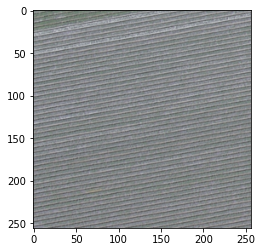

92
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


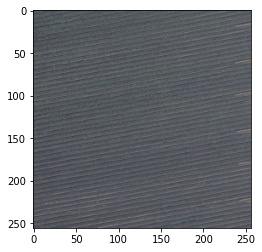

93
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


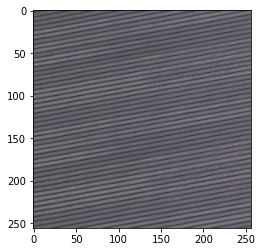

94
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


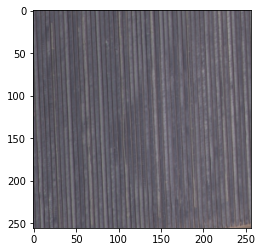

95
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


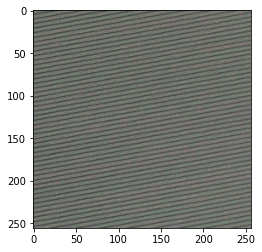

96
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


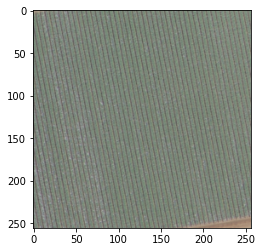

97
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


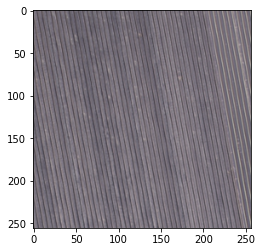

98
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


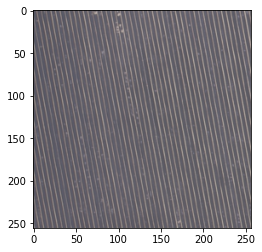

99
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


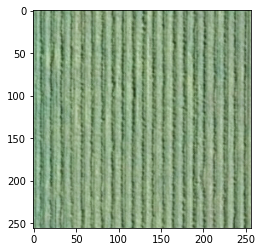

100
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is a piece of farmland
Real Caption  2 : there is a piece of cropland
Real Caption  3 : it is a piece of farmland
Real Caption  4 : it is a piece of cropland
Real Caption  5 : here is a piece of farmland
Predicted Caption: there is a piece of farmland


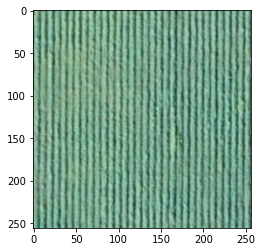

181
BLEU-1 score: 86.68778228759766
BLEU-2 score: 79.134765625
BLEU-3 score: 75.728759765625
BLEU-4 score: 72.89544677734375
Real Caption  1 : there is an airplanes stopped at the airport
Real Caption  2 : an white airplane is stopped at the airport
Real Caption  3 : there is a white airplane stopped at the airport
Real Caption  4 : an white airplane is stopped at the airport
Real Caption  5 : an white airplane is stopped at the airport
Predicted Caption: an airplane is stopped at the airport


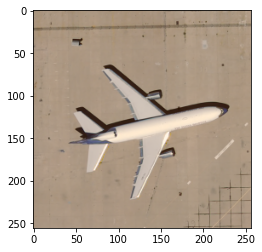

182
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there are two airplanes stopped at the airport
Real Caption  2 : two different kinds of airplanes are stopped at the airport
Real Caption  3 : two white airplanes are arranged neatly at the airport
Real Caption  4 : two airplanes stopped are at the airport
Real Caption  5 : two airplanes are stopped neatly at the airport
Predicted Caption: two airplanes are stopped at the airport


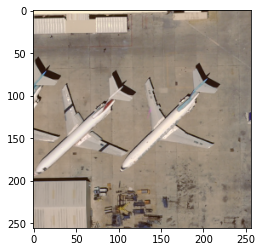

183
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there are two airplanes stopped at the airport
Real Caption  2 : two different kinds of airplanes are stopped at the airport
Real Caption  3 : two white airplanes are arranged neatly at the airport
Real Caption  4 : two airplanes stopped are at the airport
Real Caption  5 : two airplanes are stopped neatly at the airport
Predicted Caption: two airplanes are stopped at the airport


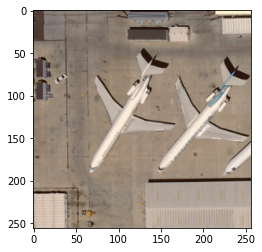

184
BLEU-1 score: 62.5
BLEU-2 score: 51.75491714477539
BLEU-3 score: 44.69517517089844
BLEU-4 score: 36.55552291870117
Real Caption  1 : there is a white airplane on the runway
Real Caption  2 : an airplane is taxiing on the runway
Real Caption  3 : an airplane is taxiing on the runway
Real Caption  4 : a white airplane is taxiing on the runway
Real Caption  5 : there is a white airplane taxiing on the runway
Predicted Caption: a white airplane is stopped at the airport


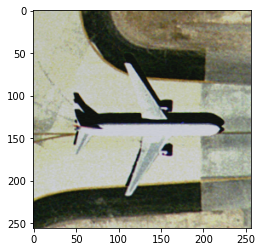

185
BLEU-1 score: 74.30381774902344
BLEU-2 score: 73.26454162597656
BLEU-3 score: 71.93582916259766
BLEU-4 score: 70.1396713256836
Real Caption  1 : there are four airplanes stopped at the airport
Real Caption  2 : four different kinds of airplanes are stopped at the airport
Real Caption  3 : four airplanes are stopped dispersedly at the airport
Real Caption  4 : four airplanes scattered at the airport
Real Caption  5 : four different airplanes are stopped dispersedly at the airport
Predicted Caption: two airplanes are stopped at the airport


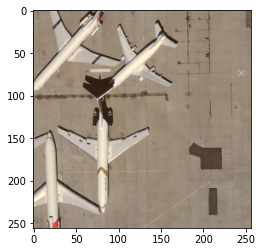

186
BLEU-1 score: 100.0
BLEU-2 score: 91.28709411621094
BLEU-3 score: 87.35804748535156
BLEU-4 score: 84.08964538574219
Real Caption  1 : there are three airplanes stopped at the airport
Real Caption  2 : three different kinds of airplanes are stopped at the airport
Real Caption  3 : three airplanes are stopped neatly at the airport
Real Caption  4 : three airplanes arranged neatly at the airport
Real Caption  5 : two grey airplanes and one white airplane are stopped at the airport
Predicted Caption: two airplanes are stopped at the airport


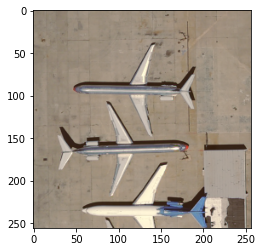

187
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there is an airplane stopped at the airport
Real Caption  2 : a white airplanes is stopped at the airport
Real Caption  3 : an airplane is stopped at the airport
Real Caption  4 : a white airplanes is stopped at the airport
Real Caption  5 : a white airplanes is stopped at the airport
Predicted Caption: an airplane is stopped at the airport


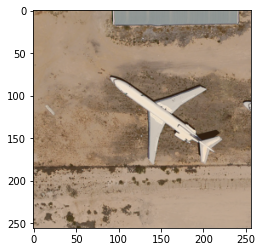

188
BLEU-1 score: 85.71428680419922
BLEU-2 score: 84.51541900634766
BLEU-3 score: 82.98265075683594
BLEU-4 score: 80.9106674194336
Real Caption  1 : there are three airplanes at the airport
Real Caption  2 : three different kinds of airplanes are stopped at the airport
Real Caption  3 : three airplanes are stopped at the airport
Real Caption  4 : three airplanes scattered at the airport
Real Caption  5 : three different airplanes are stopped dispersedly at the airport
Predicted Caption: many airplanes are stopped at the airport


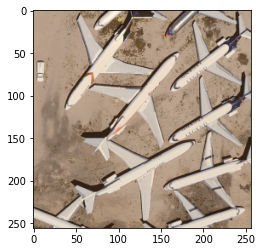

190
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there are two airplanes at the airport
Real Caption  2 : many different kinds of airplanes are stopped at the airport
Real Caption  3 : two airplanes are stopped at the airport
Real Caption  4 : two airplanes stopped at the airport with some luggage cars beside them
Real Caption  5 : two different kinds of airplanes are stopped at the airport
Predicted Caption: two airplanes are stopped at the airport


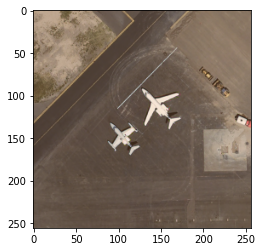

281
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a old baseball diamond
Real Caption  2 : it is a small baseball diamond with sand and grass
Real Caption  3 : it is a small old baseball diamond
Real Caption  4 : this is a old baseball diamond
Real Caption  5 : this is a old baseball diamond composed of sand and weeds
Predicted Caption: it is a small baseball diamond


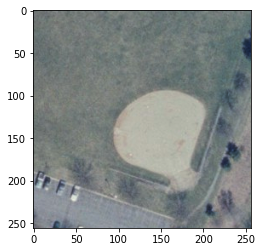

282
BLEU-1 score: 83.33332824707031
BLEU-2 score: 72.82190704345703
BLEU-3 score: 59.63867950439453
BLEU-4 score: 39.18189239501953
Real Caption  1 : this is a old baseball diamond
Real Caption  2 : it is a small baseball diamond with sand and grass
Real Caption  3 : it is a small old baseball diamond
Real Caption  4 : this is a old baseball diamond
Real Caption  5 : this is a old baseball diamond composed of sand and weeds
Predicted Caption: it is a very old baseball diamond compose of sand and weeds


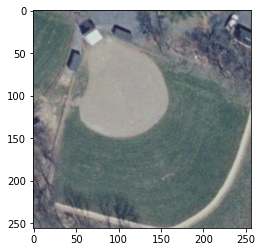

283
BLEU-1 score: 83.33332824707031
BLEU-2 score: 72.82190704345703
BLEU-3 score: 59.63867950439453
BLEU-4 score: 39.18189239501953
Real Caption  1 : this is a old baseball diamond
Real Caption  2 : it is a small baseball diamond with sand and grass
Real Caption  3 : it is a small old baseball diamond
Real Caption  4 : this is a old baseball diamond
Real Caption  5 : this is a old baseball diamond composed of sand and weeds
Predicted Caption: it is a very old baseball diamond compose of sand and weeds


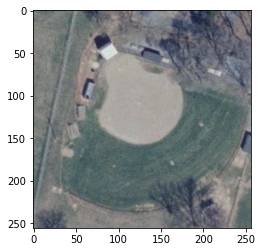

284
BLEU-1 score: 83.33332824707031
BLEU-2 score: 72.82190704345703
BLEU-3 score: 59.63867950439453
BLEU-4 score: 39.18189239501953
Real Caption  1 : this is a old baseball diamond
Real Caption  2 : it is a small baseball diamond with sand and grass
Real Caption  3 : it is a small old baseball diamond
Real Caption  4 : this is a old baseball diamond
Real Caption  5 : this is a old baseball diamond composed of sand and weeds
Predicted Caption: it is a very old baseball diamond compose of sand and weeds


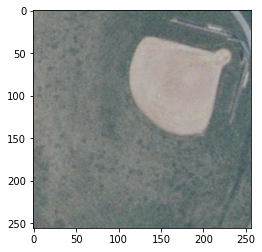

285
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a big baseball diamond
Real Caption  2 : it is a new baseball diamond with sands and grass
Real Caption  3 : it is a regular baseball diamond
Real Caption  4 : a regular baseball diamond compose of manicured lawns and sand
Real Caption  5 : a regular baseball diamond compose of manicured lawns and sand
Predicted Caption: a regular baseball diamond compose of manicured lawns and sand


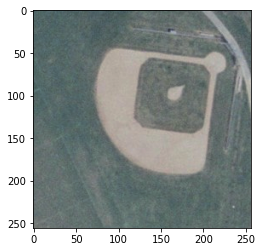

286
BLEU-1 score: 83.33332824707031
BLEU-2 score: 70.71067810058594
BLEU-3 score: 50.0
BLEU-4 score: 0.0
Real Caption  1 : this is a big baseball diamond
Real Caption  2 : it is a new baseball diamond with sands and grass
Real Caption  3 : it is a regular baseball diamond
Real Caption  4 : a regular baseball diamond compose of manicured lawns and sand
Real Caption  5 : a regular baseball diamond compose of manicured lawns and sand
Predicted Caption: it is a small baseball diamond


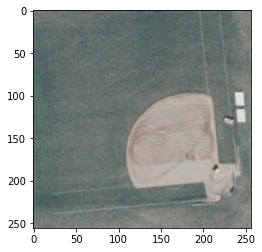

287
BLEU-1 score: 83.33332824707031
BLEU-2 score: 70.71067810058594
BLEU-3 score: 50.0
BLEU-4 score: 0.0
Real Caption  1 : this is a big baseball diamond
Real Caption  2 : it is a new baseball diamond with sands and grass
Real Caption  3 : it is a regular baseball diamond
Real Caption  4 : a regular baseball diamond compose of manicured lawns and sand
Real Caption  5 : a regular baseball diamond compose of manicured lawns and sand
Predicted Caption: it is a small baseball diamond


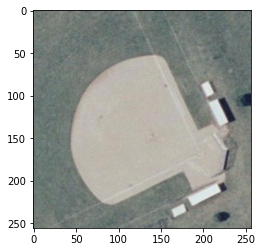

288
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a big baseball diamond
Real Caption  2 : it is a new baseball diamond with sands and grass
Real Caption  3 : it is a regular baseball diamond
Real Caption  4 : a regular baseball diamond compose of manicured lawns and sand
Real Caption  5 : a regular baseball diamond compose of manicured lawns and sand
Predicted Caption: it is a new baseball diamond with sands and grass


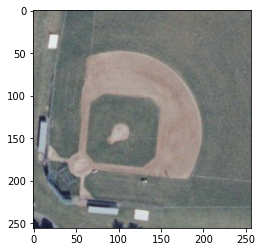

289
BLEU-1 score: 100.0
BLEU-2 score: 89.44271850585938
BLEU-3 score: 58.4803581237793
BLEU-4 score: 0.0
Real Caption  1 : this is a baseball diamond
Real Caption  2 : it is an old baseball diamond with sands and grass
Real Caption  3 : it is an old baseball diamond
Real Caption  4 : an old small baseball diamond compose of weeds and sands
Real Caption  5 : an old baseball diamond compose of weeds and sands
Predicted Caption: it is a small baseball diamond


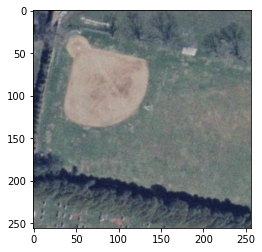

290
BLEU-1 score: 60.000003814697266
BLEU-2 score: 44.72135925292969
BLEU-3 score: 36.84031677246094
BLEU-4 score: 29.071537017822266
Real Caption  1 : this is a baseball diamond
Real Caption  2 : it is an old baseball diamond with sands and grass
Real Caption  3 : it is an old baseball diamond
Real Caption  4 : an old small baseball diamond compose of weeds and sands
Real Caption  5 : an old baseball diamond compose of weeds and sands
Predicted Caption: a regular baseball diamond compose of manicured lawns and sand


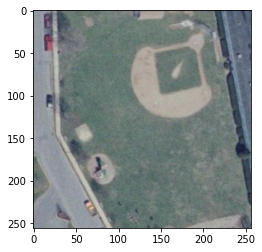

381
BLEU-1 score: 54.54545593261719
BLEU-2 score: 33.02891159057617
BLEU-3 score: 0.0
BLEU-4 score: 0.0
Real Caption  1 : this is a beach with blue green sea and white sand
Real Caption  2 : the sea water melt into the sand beach
Real Caption  3 : the sea water melt into the sand beach
Real Caption  4 : the sand beach mixed with the waters
Real Caption  5 : the sand beach melt into the blue green sea
Predicted Caption: the waves slapping a white sand beach over and over again


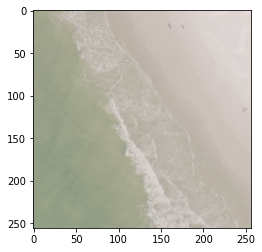

382
BLEU-1 score: 54.54545593261719
BLEU-2 score: 33.02891159057617
BLEU-3 score: 0.0
BLEU-4 score: 0.0
Real Caption  1 : this is a beach with blue green sea and white sand
Real Caption  2 : the sea water melt into the sand beach
Real Caption  3 : the sea water melt into the sand beach
Real Caption  4 : the sand beach mixed with the waters
Real Caption  5 : the sand beach melt into the blue green sea
Predicted Caption: the waves slapping a white sand beach over and over again


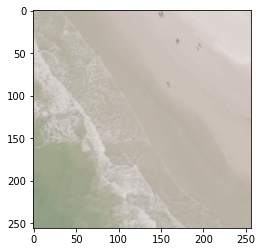

383
BLEU-1 score: 81.43535614013672
BLEU-2 score: 75.7041244506836
BLEU-3 score: 68.69047546386719
BLEU-4 score: 59.541648864746094
Real Caption  1 : this is a beach with blue green sea and white sand
Real Caption  2 : the sea water melt into the sand beach
Real Caption  3 : the sea water melt into the sand beach
Real Caption  4 : the sand beach mixed with the waters
Real Caption  5 : the sand beach melt into the blue green sea
Predicted Caption: this is a beach with blue sea and white sands


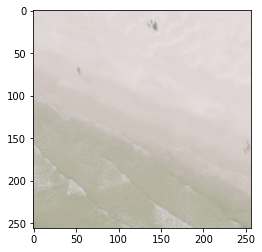

384
BLEU-1 score: 81.43535614013672
BLEU-2 score: 75.7041244506836
BLEU-3 score: 68.69047546386719
BLEU-4 score: 59.541648864746094
Real Caption  1 : this is a beach with blue green sea and white sand
Real Caption  2 : the sea water melt into the sand beach
Real Caption  3 : the sea water melt into the sand beach
Real Caption  4 : the sand beach mixed with the waters
Real Caption  5 : the sand beach melt into the blue green sea
Predicted Caption: this is a beach with blue sea and white sands


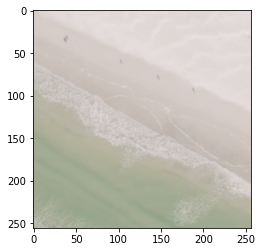

385
BLEU-1 score: 56.4321174621582
BLEU-2 score: 43.712127685546875
BLEU-3 score: 0.0
BLEU-4 score: 0.0
Real Caption  1 : this is a beach with blue green sea and white sand
Real Caption  2 : the sea water melt into the sand beach
Real Caption  3 : the sea water melt into the sand beach
Real Caption  4 : the sand beach mixed with the waters
Real Caption  5 : the sand beach melt into the blue green sea
Predicted Caption: waves slapping a white sand beach


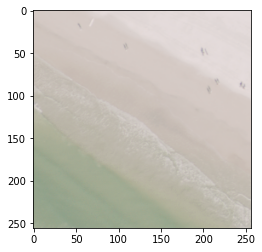

386
BLEU-1 score: 84.6481704711914
BLEU-2 score: 84.6481704711914
BLEU-3 score: 84.6481704711914
BLEU-4 score: 84.6481704711914
Real Caption  1 : this is a beach with blue green sea and white sands
Real Caption  2 : waves slapping a white sand beach throw up white foams
Real Caption  3 : a beautiful beach with some people and cars
Real Caption  4 : blue green sea and white sands with some people on the beach
Real Caption  5 : some plants and people on the beach
Predicted Caption: waves slapping a white sand beach


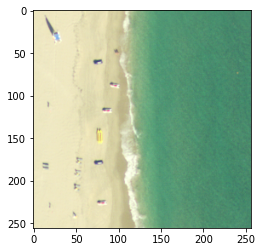

387
BLEU-1 score: 100.0
BLEU-2 score: 94.2809066772461
BLEU-3 score: 87.35804748535156
BLEU-4 score: 78.56293487548828
Real Caption  1 : this is a beach with blue green sea and white sands
Real Caption  2 : waves slapping a white sand beach throw up white foams
Real Caption  3 : a beautiful beach with some people and cars
Real Caption  4 : blue green sea and white sands with some people on the beach
Real Caption  5 : some plants and people on the beach
Predicted Caption: this is a beach with blue sea and white sands


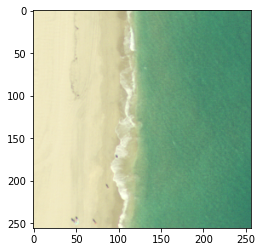

388
BLEU-1 score: 100.0
BLEU-2 score: 94.2809066772461
BLEU-3 score: 87.35804748535156
BLEU-4 score: 78.56293487548828
Real Caption  1 : this is a beach with blue green sea and white sands
Real Caption  2 : waves slapping a white sand beach throw up white foams
Real Caption  3 : a beautiful beach with some people and cars
Real Caption  4 : blue green sea and white sands with some people on the beach
Real Caption  5 : some plants and people on the beach
Predicted Caption: this is a beach with blue sea and white sands


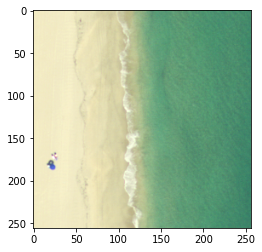

389
BLEU-1 score: 100.0
BLEU-2 score: 94.2809066772461
BLEU-3 score: 87.35804748535156
BLEU-4 score: 78.56293487548828
Real Caption  1 : this is a beach with blue green sea and white sands
Real Caption  2 : waves slapping a white sand beach throw up white foams
Real Caption  3 : a beautiful beach with some people and cars
Real Caption  4 : blue green sea and white sands with some people on the beach
Real Caption  5 : some plants and people on the beach
Predicted Caption: this is a beach with blue sea and white sands


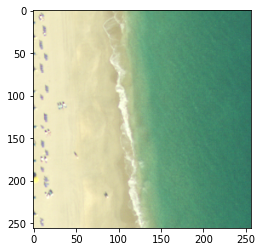

390
BLEU-1 score: 100.0
BLEU-2 score: 94.2809066772461
BLEU-3 score: 87.35804748535156
BLEU-4 score: 78.56293487548828
Real Caption  1 : this is a beach with blue green sea and white sands
Real Caption  2 : waves slapping a white sand beach
Real Caption  3 : waves slapping the white sand beach throw up white foams
Real Caption  4 : beautiful beach with blue green sea and white sand
Real Caption  5 : the beach is composed of clear green waters and white sands
Predicted Caption: this is a beach with blue sea and white sands


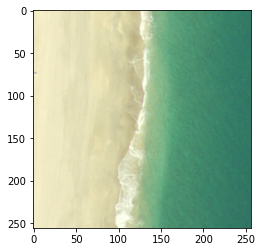

481
BLEU-1 score: 38.940040588378906
BLEU-2 score: 0.0
BLEU-3 score: 0.0
BLEU-4 score: 0.0
Real Caption  1 : there is a triangular building with grey roofs
Real Caption  2 : a triangular building with grey roofss
Real Caption  3 : a triangular building with grey roofs and some cars parked beside it
Real Caption  4 : there is a triangular building with some cars parked beside it
Real Caption  5 : a triangular building and cars
Predicted Caption: there are some buildings


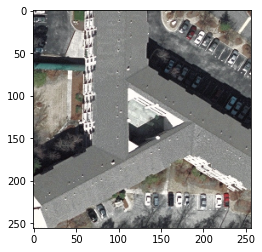

482
BLEU-1 score: 11.764705657958984
BLEU-2 score: 0.0
BLEU-3 score: 0.0
BLEU-4 score: 0.0
Real Caption  1 : there are some buildings with white and grey roofs
Real Caption  2 : some buildings with white and grey roofs
Real Caption  3 : there are some buildings with cars parked beside them
Real Caption  4 : there are some buildings with cars parked beside them
Real Caption  5 : buildings and cars
Predicted Caption: it is a river with a road on one bank and a road on the other side


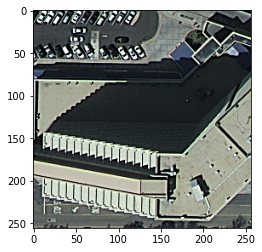

483
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there are some buildings with white and grey roofs
Real Caption  2 : some buildings with white and grey roofs
Real Caption  3 : there are some buildings with cars parked beside them
Real Caption  4 : there are some buildings with cars parked beside them
Real Caption  5 : buildings and cars
Predicted Caption: there are some buildings


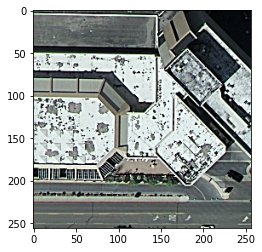

484
BLEU-1 score: 57.142860412597656
BLEU-2 score: 43.643577575683594
BLEU-3 score: 33.6478157043457
BLEU-4 score: 0.0
Real Caption  1 : there are some buildings with white and grey roofs
Real Caption  2 : some buildings with white and grey roofs
Real Caption  3 : there are some buildings with cars parked beside them
Real Caption  4 : there are some buildings with cars parked beside them
Real Caption  5 : buildings and cars
Predicted Caption: there are some cars on the road


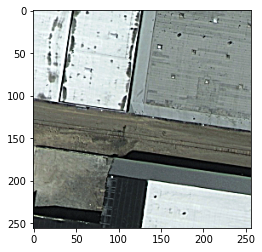

485
BLEU-1 score: 60.65306854248047
BLEU-2 score: 60.65306854248047
BLEU-3 score: 48.1403694152832
BLEU-4 score: 0.0
Real Caption  1 : there are some building with grey roofs
Real Caption  2 : some buildings with grey roof and some cars parked beside them
Real Caption  3 : there is a hexagonal building with some cars parked beside them
Real Caption  4 : there is a hexagonal building with grey roofs
Real Caption  5 : a hexagonal building with grey roofs
Predicted Caption: there are some buildings


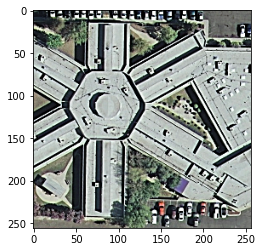

486
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there are some buildings with brown and black roofs
Real Caption  2 : some buildings with brown and black roofs
Real Caption  3 : some buildings with brown and black roofs
Real Caption  4 : there are buildings and some plants
Real Caption  5 : buildings and plants
Predicted Caption: there are some buildings


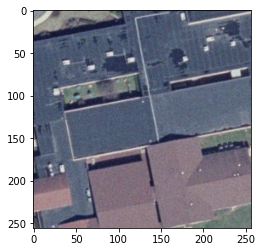

487
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there are some buildings with grey roofs
Real Caption  2 : buildings with grey roofs
Real Caption  3 : there are some buildings pressed together
Real Caption  4 : some buildings with grey roofs are pressed together
Real Caption  5 : some buildings are pressed together
Predicted Caption: there are some buildings


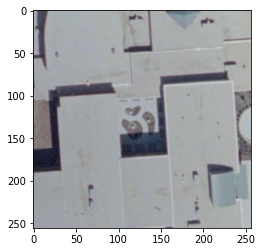

488
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there are some buildings with grey roofs
Real Caption  2 : buildings with grey roofs
Real Caption  3 : there are some buildings pressed together
Real Caption  4 : some buildings with grey roofs are pressed together
Real Caption  5 : some buildings are pressed together
Predicted Caption: there are some buildings


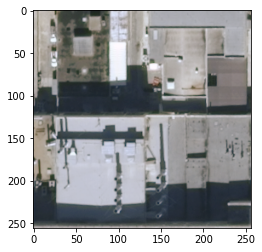

489
BLEU-1 score: 46.153846740722656
BLEU-2 score: 19.61161231994629
BLEU-3 score: 0.0
BLEU-4 score: 0.0
Real Caption  1 : there are some buildings with different colors of roofs
Real Caption  2 : some buildings with different colors of roofs
Real Caption  3 : there are some buildings pressed together with some cars parked beside them
Real Caption  4 : there are some cars parked beside the buildings
Real Caption  5 : buildings and cars
Predicted Caption: there are lots of houses arranged neatly and some roads go through them


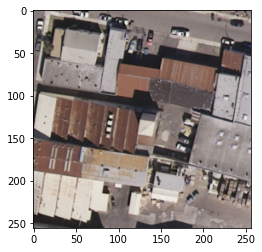

490
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : there are some buildings with different colors of roofs
Real Caption  2 : some buildings with different colors of roofs
Real Caption  3 : there are some buildings pressed together with some cars parked beside them
Real Caption  4 : there are some cars parked beside the buildings
Real Caption  5 : buildings and cars
Predicted Caption: there are some buildings


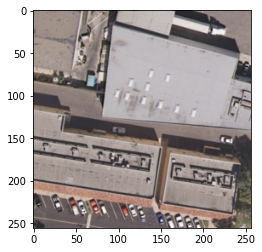

581
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: lots of plants scattered in the loess ground


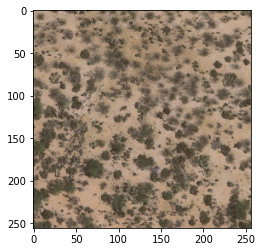

582
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: lots of plants scattered in the loess ground


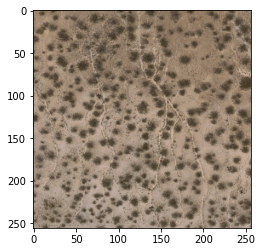

583
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: there are some grey plants scattered on the ground


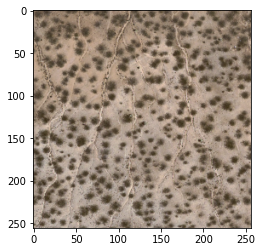

584
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: some grey plants are scattered in the loess ground


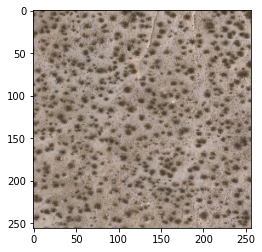

585
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: there are some grey plants scattered on the ground


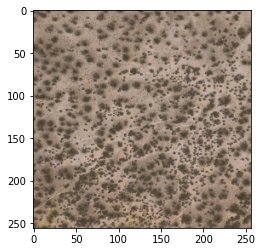

586
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: lots of plants scattered in the loess ground


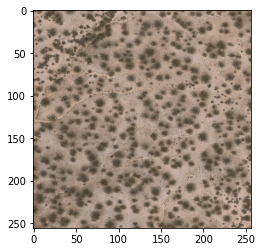

587
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: lots of plants scattered in the loess ground


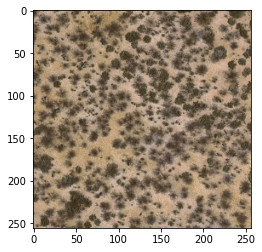

588
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: lots of plants scattered in the loess ground


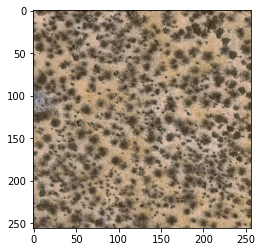

589
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: lots of plants scattered in the loess ground


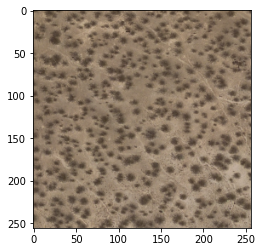

590
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a chaparral
Real Caption  2 : lots of plants scattered on the ground
Real Caption  3 : lots of plants scattered in the loess ground
Real Caption  4 : there are some grey plants scattered on the ground
Real Caption  5 : some grey plants are scattered in the loess ground
Predicted Caption: lots of plants scattered in the loess ground


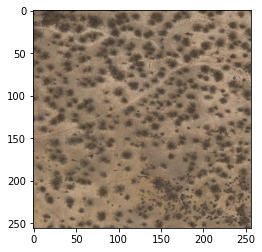

614
BLEU-1 score: 76.92308044433594
BLEU-2 score: 66.98641204833984
BLEU-3 score: 54.644561767578125
BLEU-4 score: 35.74046325683594
Real Caption  1 : this is a dense residential area with houses and roads
Real Caption  2 : it is a dense residential area with lots of houses pressed together
Real Caption  3 : there are lots of houses pressed together wothe a road goes through them
Real Caption  4 : lots of houses are pressed together
Real Caption  5 : lots of houses pressed together and a road goes through them
Predicted Caption: it is a medium residential area with a road goes through this area


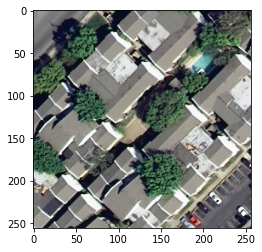

615
BLEU-1 score: 84.61538696289062
BLEU-2 score: 70.25594329833984
BLEU-3 score: 56.40849304199219
BLEU-4 score: 36.602298736572266
Real Caption  1 : this is a dense residential area
Real Caption  2 : it is a dense residential area with many houses arranged neatly and a road goes through them
Real Caption  3 : there are lots of houses arranged neatly and a road goes through them
Real Caption  4 : lots of houses with grey roofs arranged neatly and a road goes through them
Real Caption  5 : lots of houses arranged neatly and a road goes through them
Predicted Caption: it is a medium residential area with a road goes through this area


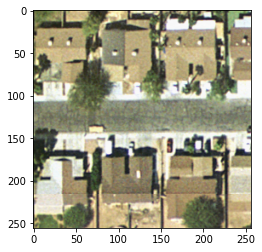

616
BLEU-1 score: 92.00443267822266
BLEU-2 score: 87.72279357910156
BLEU-3 score: 82.7385482788086
BLEU-4 score: 76.7733154296875
Real Caption  1 : this is a dense residential area
Real Caption  2 : it is a dense residential area with many houses arranged neatly and a road goes through them
Real Caption  3 : there are lots of houses arranged neatly and a road goes through them
Real Caption  4 : lots of houses with grey roofs arranged neatly and a road goes through them
Real Caption  5 : lots of houses arranged neatly and a road goes through them
Predicted Caption: it is a dense residential area with lots of houses arranged neatly


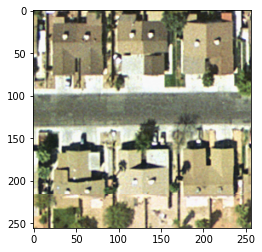

681
BLEU-1 score: 54.54545593261719
BLEU-2 score: 46.709938049316406
BLEU-3 score: 41.74127960205078
BLEU-4 score: 36.72056198120117
Real Caption  1 : this is a dense residential area with houses and plants
Real Caption  2 : it is a dense residential area with lots of houses arranged neatly
Real Caption  3 : there ars lots of houses with orange roofs arranged neatly
Real Caption  4 : lots of houses with orange roofs arranged neatly in the dense residential area
Real Caption  5 : this is a dense residential area with many houses arranged neatly
Predicted Caption: lots of houses arranged neatly and some roads go through them


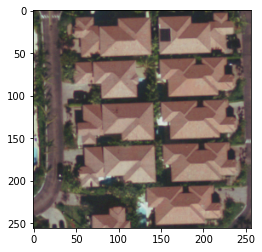

682
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a dense residential area with houses and plants
Real Caption  2 : it is a dense residential area with lots of houses arranged neatly
Real Caption  3 : there ars lots of houses with orange roofs arranged neatly
Real Caption  4 : lots of houses with orange roofs arranged neatly in the dense residential area
Real Caption  5 : this is a dense residential area with many houses arranged neatly
Predicted Caption: it is a dense residential area with lots of houses arranged neatly


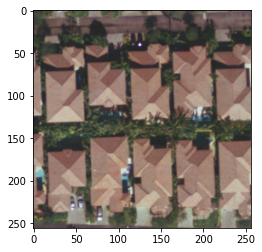

683
BLEU-1 score: 84.61538696289062
BLEU-2 score: 70.25594329833984
BLEU-3 score: 56.40849304199219
BLEU-4 score: 36.602298736572266
Real Caption  1 : this is a dense residential area with houses and plants
Real Caption  2 : it is a dense residential area with lots of houses with black roofs arranged neatly and a road goes through them
Real Caption  3 : there ars lots of houses with black roofs arranged neatly and a road goes through them
Real Caption  4 : lots of houses with black roofs arranged neatly and a road goes through them
Real Caption  5 : lots of houses with black roofs arranged neatly with some plants around them
Predicted Caption: it is a medium residential area with a road goes through this area


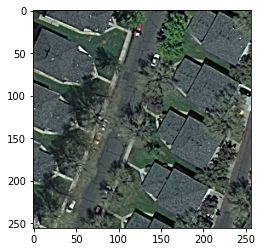

684
BLEU-1 score: 92.00443267822266
BLEU-2 score: 87.72279357910156
BLEU-3 score: 82.7385482788086
BLEU-4 score: 79.78973388671875
Real Caption  1 : this is a dense residential area with houses and plants
Real Caption  2 : it is a dense residential area with lots of houses with black roofs arranged neatly and a road goes through them
Real Caption  3 : there ars lots of houses with black roofs arranged neatly and a road goes through them
Real Caption  4 : lots of houses with black roofs arranged neatly and a road goes through them
Real Caption  5 : lots of houses with black roofs arranged neatly with some plants around them
Predicted Caption: it is a dense residential area with lots of houses arranged neatly


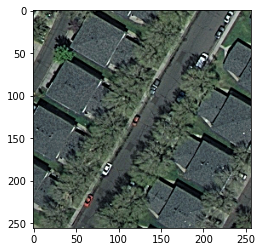

685
BLEU-1 score: 71.42857360839844
BLEU-2 score: 66.29935455322266
BLEU-3 score: 63.529945373535156
BLEU-4 score: 61.153804779052734
Real Caption  1 : this is a dense residential area with houses and plants
Real Caption  2 : it is a dense residential area with lots of houses and plants
Real Caption  3 : there ars lots of houses arranged neatly and some plants around them
Real Caption  4 : lots of houses arranged neatly and some cars parked beaide them
Real Caption  5 : lots of houses arranged neatly and some cars parked beaide them
Predicted Caption: it is a dense residential area with houses and a road goes through them


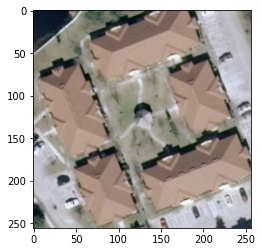

686
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a dense residential area with houses and plants
Real Caption  2 : it is a dense residential area with lots of houses and plants
Real Caption  3 : there ars lots of houses arranged neatly and some plants around them
Real Caption  4 : lots of houses arranged neatly and some cars parked beaide them
Real Caption  5 : lots of houses arranged neatly and some cars parked beaide them
Predicted Caption: it is a dense residential area with lots of houses arranged neatly


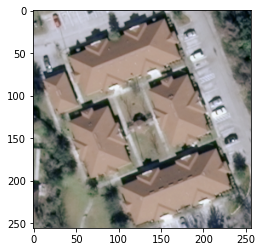

687
BLEU-1 score: 46.153846740722656
BLEU-2 score: 39.223228454589844
BLEU-3 score: 30.355772018432617
BLEU-4 score: 0.0
Real Caption  1 : this is a dense residential area with some houses
Real Caption  2 : it is a dense residential area with some houses arranged neatly
Real Caption  3 : there ars some houses arranged neatly and some cars parked beside them
Real Caption  4 : some houses arranged neatly and some cars parked beside them
Real Caption  5 : there is a dense residential area with many houses and cars
Predicted Caption: this is a sparse residential area with a road goes through this area


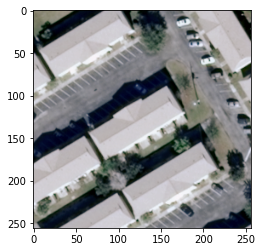

688
BLEU-1 score: 77.77777862548828
BLEU-2 score: 74.09585571289062
BLEU-3 score: 72.26924133300781
BLEU-4 score: 70.82594299316406
Real Caption  1 : this is a dense residential area with some houses
Real Caption  2 : it is a dense residential area with lots of houses arranged neatly
Real Caption  3 : there ars lots of houses arranged neatly and some cars parked beside them
Real Caption  4 : lots of houses arranged neatly and some cars parked beside them
Real Caption  5 : there is a dense residential area with many houses arranged neatly
Predicted Caption: it is a dense residential area with lots of houses arranged neatly and a road goes through them


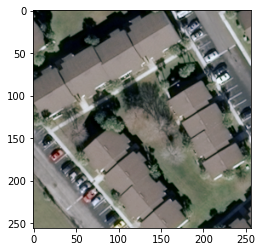

689
BLEU-1 score: 58.10640335083008
BLEU-2 score: 46.068206787109375
BLEU-3 score: 35.05120086669922
BLEU-4 score: 26.477951049804688
Real Caption  1 : this is a dense residential area with some houses
Real Caption  2 : it is a dense residential area with lots of houses arranged in lines
Real Caption  3 : there ars lots of houses arranged in lines and some cars parked beside them
Real Caption  4 : lots of houses arranged in lines and some cars parked beside them
Real Caption  5 : there is a dense residential area with many houses arranged in lines
Predicted Caption: lots of houses arranged neatly and some roads go through them


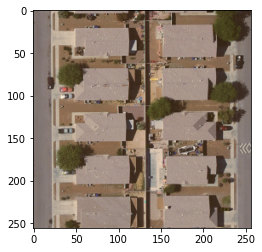

690
BLEU-1 score: 58.10640335083008
BLEU-2 score: 46.068206787109375
BLEU-3 score: 35.05120086669922
BLEU-4 score: 26.477951049804688
Real Caption  1 : this is a dense residential area with some houses
Real Caption  2 : it is a dense residential area with lots of houses arranged in lines
Real Caption  3 : there ars lots of houses arranged in lines and some cars parked beside them
Real Caption  4 : lots of houses arranged in lines and some cars parked beside them
Real Caption  5 : there is a dense residential area with many houses arranged in lines
Predicted Caption: lots of houses arranged neatly and some roads go through them


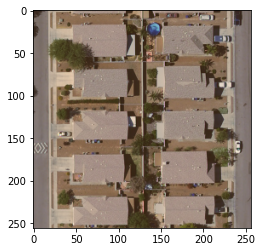

781
BLEU-1 score: 100.0
BLEU-2 score: 89.44271850585938
BLEU-3 score: 76.31428527832031
BLEU-4 score: 57.73502731323242
Real Caption  1 : this is a dense forest with lots of plants
Real Caption  2 : this is a dense forest with green plants and dotted with some dark green trees
Real Caption  3 : there are lots of green plants and dotted with some dark green plants
Real Caption  4 : lots of green plants dotted with some dark green plants in the forest
Real Caption  5 : lots of green plants in the dense forest
Predicted Caption: there are lots of dark green trees in the dense forest


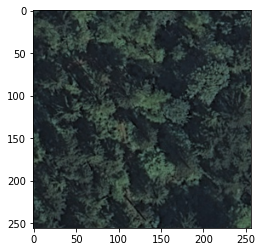

782
BLEU-1 score: 100.0
BLEU-2 score: 89.44271850585938
BLEU-3 score: 76.31428527832031
BLEU-4 score: 57.73502731323242
Real Caption  1 : this is a dense forest with lots of plants
Real Caption  2 : this is a dense forest with green plants and dotted with some dark green trees
Real Caption  3 : there are lots of green plants and dotted with some dark green plants
Real Caption  4 : lots of green plants dotted with some dark green plants in the forest
Real Caption  5 : lots of green plants in the dense forest
Predicted Caption: there are lots of dark green trees in the dense forest


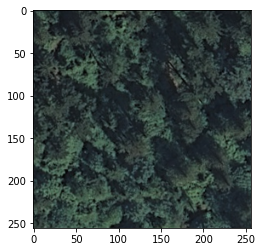

783
BLEU-1 score: 100.0
BLEU-2 score: 89.44271850585938
BLEU-3 score: 76.31428527832031
BLEU-4 score: 57.73502731323242
Real Caption  1 : this is a dense forest with lots of plants
Real Caption  2 : this is a dense forest with green plants and dotted with some dark green trees
Real Caption  3 : there are lots of green plants and dotted with some dark green plants
Real Caption  4 : lots of green plants dotted with some dark green plants in the forest
Real Caption  5 : lots of green plants in the dense forest
Predicted Caption: there are lots of dark green trees in the dense forest


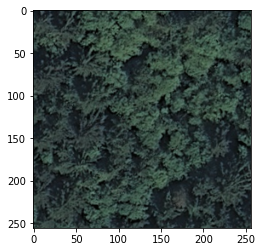

784
BLEU-1 score: 100.0
BLEU-2 score: 89.44271850585938
BLEU-3 score: 76.31428527832031
BLEU-4 score: 57.73502731323242
Real Caption  1 : this is a dense forest with lots of plants
Real Caption  2 : this is a dense forest with green plants and dotted with some dark green trees
Real Caption  3 : there are lots of green plants and dotted with some dark green plants
Real Caption  4 : lots of green plants dotted with some dark green plants in the forest
Real Caption  5 : lots of green plants in the dense forest
Predicted Caption: there are lots of dark green trees in the dense forest


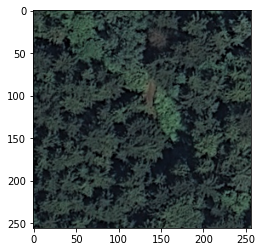

785
BLEU-1 score: 100.0
BLEU-2 score: 89.44271850585938
BLEU-3 score: 76.31428527832031
BLEU-4 score: 57.73502731323242
Real Caption  1 : this is a dense forest with lots of plants
Real Caption  2 : this is a dense forest with green plants and dotted with some dark green trees
Real Caption  3 : there are lots of green plants and dotted with some dark green plants
Real Caption  4 : lots of green plants dotted with some dark green plants in the forest
Real Caption  5 : lots of green plants in the dense forest
Predicted Caption: there are lots of dark green trees in the dense forest


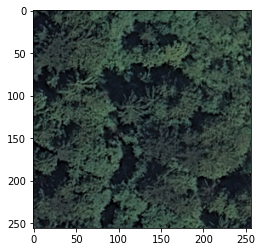

786
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a dense forest with lots of dark green trees
Real Caption  2 : there are lots of dark green plants in the dense forest
Real Caption  3 : there are lots of dark green trees in the dense forest
Real Caption  4 : lots of dark green trees constitute a dense forest
Real Caption  5 : lots of dark green trees constitute a dense forest
Predicted Caption: there are lots of dark green trees in the dense forest


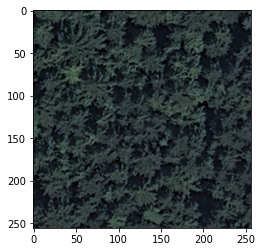

787
BLEU-1 score: 90.90909576416016
BLEU-2 score: 79.77239990234375
BLEU-3 score: 65.64086151123047
BLEU-4 score: 51.56626892089844
Real Caption  1 : this is a dense forest with green and dark green plants
Real Caption  2 : lots of green and dark green plants constitute a dense forest
Real Caption  3 : there are lots of green and dark green plants in the dense forest
Real Caption  4 : there are lots of green plants and dotted with some dark green plants
Real Caption  5 : there are lots of green plants
Predicted Caption: there are lots of dark green trees in the dense forest


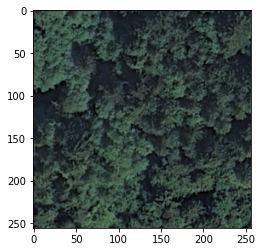

788
BLEU-1 score: 90.90909576416016
BLEU-2 score: 79.77239990234375
BLEU-3 score: 65.64086151123047
BLEU-4 score: 51.56626892089844
Real Caption  1 : this is a dense forest with green and dark green plants
Real Caption  2 : lots of green and dark green plants constitute a dense forest
Real Caption  3 : there are lots of green and dark green plants in the dense forest
Real Caption  4 : there are lots of green plants and dotted with some dark green plants
Real Caption  5 : there are lots of green plants
Predicted Caption: there are lots of dark green trees in the dense forest


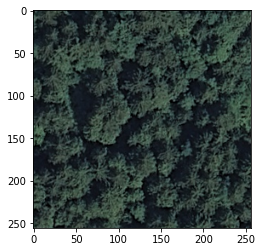

789
BLEU-1 score: 90.90909576416016
BLEU-2 score: 79.77239990234375
BLEU-3 score: 65.64086151123047
BLEU-4 score: 51.56626892089844
Real Caption  1 : this is a dense forest with green and dark green plants
Real Caption  2 : lots of green and dark green plants constitute a dense forest
Real Caption  3 : there are lots of green and dark green plants in the dense forest
Real Caption  4 : there are lots of green plants and dotted with some dark green plants
Real Caption  5 : there are lots of green plants
Predicted Caption: there are lots of dark green trees in the dense forest


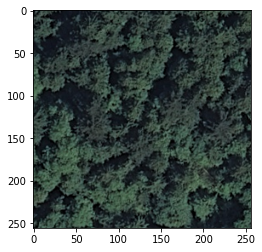

790
BLEU-1 score: 90.90909576416016
BLEU-2 score: 79.77239990234375
BLEU-3 score: 65.64086151123047
BLEU-4 score: 51.56626892089844
Real Caption  1 : this is a dense forest with green and dark green plants
Real Caption  2 : lots of green and dark green plants constitute a dense forest
Real Caption  3 : there are lots of green and dark green plants in the dense forest
Real Caption  4 : there are lots of green plants and dotted with some dark green plants
Real Caption  5 : there are lots of green plants
Predicted Caption: there are lots of dark green trees in the dense forest


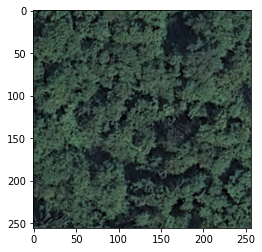

881
BLEU-1 score: 90.0
BLEU-2 score: 83.66600036621094
BLEU-3 score: 75.91472625732422
BLEU-4 score: 65.80370330810547
Real Caption  1 : there are two curved freeways closed together
Real Caption  2 : there are two curved freeways closed together with some cars on them
Real Caption  3 : two curved freeways closed together with some cars on them
Real Caption  4 : two curved freeways closed together with some plants beside them
Real Caption  5 : two curved freeways with some plants beside them
Predicted Caption: there are two straight freeways with some plants beside them


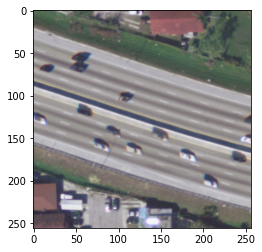

882
BLEU-1 score: 53.62560272216797
BLEU-2 score: 42.39476013183594
BLEU-3 score: 34.24483871459961
BLEU-4 score: 0.0
Real Caption  1 : there are two curved freeways closed together
Real Caption  2 : there are two curved freeways closed together with some cars on them
Real Caption  3 : two curved freeways closed together with some cars on them
Real Caption  4 : two curved freeways closed together with some plants beside them
Real Caption  5 : two curved freeways with some plants beside them
Predicted Caption: two straight freeways closed together


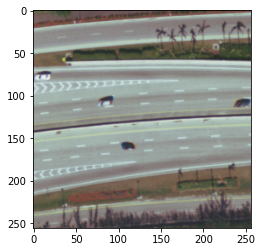

883
BLEU-1 score: 71.42857360839844
BLEU-2 score: 69.00655364990234
BLEU-3 score: 65.8633804321289
BLEU-4 score: 61.478816986083984
Real Caption  1 : two straight freeways parrallel forward
Real Caption  2 : two straight freeways parrallel forward with some cars on them
Real Caption  3 : two straight freeways closed together with some cars on them
Real Caption  4 : two freeways closed together with some cars on them
Real Caption  5 : two straight freeways parrallel forward with some cars on them
Predicted Caption: there are two straight freeways closed together


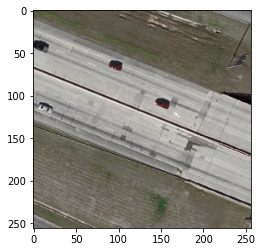

884
BLEU-1 score: 44.4444465637207
BLEU-2 score: 40.8248291015625
BLEU-3 score: 36.246009826660156
BLEU-4 score: 29.847461700439453
Real Caption  1 : two straight freeways parrallel forward
Real Caption  2 : two straight freeways parrallel forward with some cars on them
Real Caption  3 : two straight freeways closed together with some cars on them
Real Caption  4 : two freeways closed together with some cars on them
Real Caption  5 : two straight freeways parrallel forward with some cars on them
Predicted Caption: there are two straight freeways closed to each other


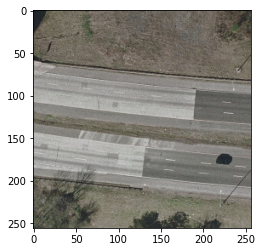

885
BLEU-1 score: 44.4444465637207
BLEU-2 score: 40.8248291015625
BLEU-3 score: 36.246009826660156
BLEU-4 score: 29.847461700439453
Real Caption  1 : two straight freeways parrallel forward
Real Caption  2 : two straight freeways parrallel forward with some cars on them
Real Caption  3 : two straight freeways closed together with some cars on them
Real Caption  4 : two freeways closed together with some cars on them
Real Caption  5 : two straight freeways parrallel forward with some cars on them
Predicted Caption: there are two straight freeways closed to each other


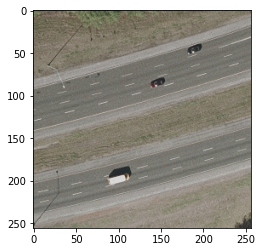

886
BLEU-1 score: 44.4444465637207
BLEU-2 score: 40.8248291015625
BLEU-3 score: 36.246009826660156
BLEU-4 score: 29.847461700439453
Real Caption  1 : two straight freeways parrallel forward
Real Caption  2 : two straight freeways parrallel forward with some cars on them
Real Caption  3 : two straight freeways closed together with some cars on them
Real Caption  4 : two freeways closed together with some cars on them
Real Caption  5 : two straight freeways parrallel forward with some cars on them
Predicted Caption: there are two straight freeways closed to each other


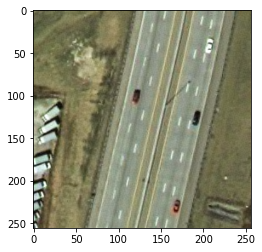

887
BLEU-1 score: 66.66667175292969
BLEU-2 score: 64.54972076416016
BLEU-3 score: 56.31239318847656
BLEU-4 score: 41.535091400146484
Real Caption  1 : there are two wide straight freeways parrallel forward
Real Caption  2 : there are two wide straight freeways closed together with with some cars on them
Real Caption  3 : two straight freeways parrallel forward with with some cars on them
Real Caption  4 : two straight freeways closed together
Real Caption  5 : two straight freeways parrallel forward with some cars on them
Predicted Caption: there are two straight freeways closed to each other


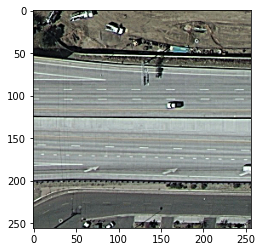

888
BLEU-1 score: 86.68778228759766
BLEU-2 score: 86.68778228759766
BLEU-3 score: 80.47380828857422
BLEU-4 score: 68.94026184082031
Real Caption  1 : there are two wide straight freeways parrallel forward
Real Caption  2 : there are two wide straight freeways closed together with with some cars on them
Real Caption  3 : two straight freeways parrallel forward with with some cars on them
Real Caption  4 : two straight freeways closed together
Real Caption  5 : two straight freeways parrallel forward with some cars on them
Predicted Caption: there are two straight freeways closed together


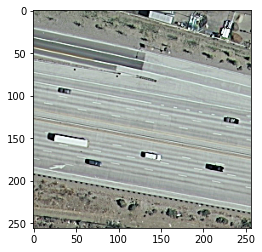

889
BLEU-1 score: 66.66667175292969
BLEU-2 score: 64.54972076416016
BLEU-3 score: 56.31239318847656
BLEU-4 score: 41.535091400146484
Real Caption  1 : there are two wide straight freeways parrallel forward
Real Caption  2 : there are two wide straight freeways closed together with with some cars on them
Real Caption  3 : two straight freeways parrallel forward with with some cars on them
Real Caption  4 : two straight freeways closed together
Real Caption  5 : two straight freeways parrallel forward with some cars on them
Predicted Caption: there are two straight freeways closed to each other


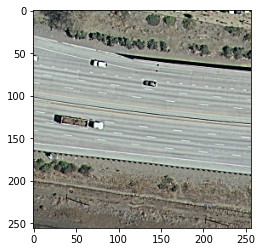

890
BLEU-1 score: 66.66667175292969
BLEU-2 score: 61.721343994140625
BLEU-3 score: 52.71883773803711
BLEU-4 score: 33.24137878417969
Real Caption  1 : there are two white straight freeways parrallel forward
Real Caption  2 : there are two white straight freeways closed together with with cars on them
Real Caption  3 : two straight freeways parrallel forward with with some cars on them
Real Caption  4 : two white straight freeways closed together
Real Caption  5 : two straight freeways parrallel forward with some cars on them
Predicted Caption: there are two straight freeways closed to each other with some cars on the roads


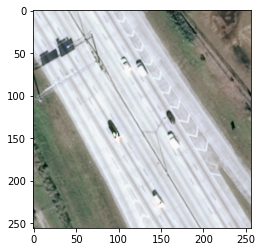

981
BLEU-1 score: 40.43537902832031
BLEU-2 score: 22.147367477416992
BLEU-3 score: 0.0
BLEU-4 score: 0.0
Real Caption  1 : this is a part of a golf course with green turfs and some trees
Real Caption  2 : a part of a golf course with green turfs and some trees
Real Caption  3 : a part of a golf course with green turfs and some trees
Real Caption  4 : there are turfs and some trees in the golf course
Real Caption  5 : green turfs and some trees in the golf course
Predicted Caption: there is a piece of farmland


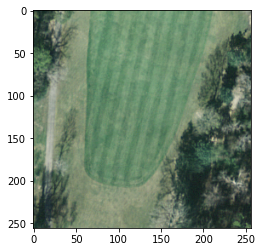

982
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a part of a golf course with green turfs and some bunkers and trees
Real Caption  2 : a part of a golf course with green turfs and some bunkers and trees
Real Caption  3 : a part of a golf course with green turfs and some trees
Real Caption  4 : there are turfs and some bunkers and trees in the golf course
Real Caption  5 : green turfs and some bunkers and trees in the golf course
Predicted Caption: a part of a golf course with green turfs and some bunkers and trees


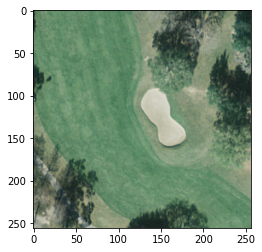

983
BLEU-1 score: 93.10628509521484
BLEU-2 score: 89.45362854003906
BLEU-3 score: 88.06339263916016
BLEU-4 score: 87.19532012939453
Real Caption  1 : this is a part of a golf course with green turfs and some bunkers and a trail go through the turfs
Real Caption  2 : a part of a golf course with green turfs and some bunkers and withered trees
Real Caption  3 : a part of a golf course with green turfs and some bunkers and a trail go through the turfs
Real Caption  4 : there are turfs and some bunkers and withered trees in the golf course
Real Caption  5 : green turfs and some bunkers and a trail go through the turfs in the golf course
Predicted Caption: a part of a golf course with green turfs and some bunkers and trees


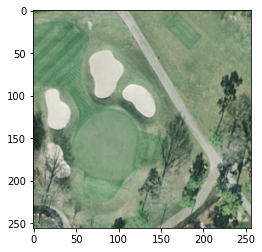

984
BLEU-1 score: 93.10628509521484
BLEU-2 score: 89.45362854003906
BLEU-3 score: 88.06339263916016
BLEU-4 score: 87.19532012939453
Real Caption  1 : this is a part of a golf course with green turfs and some bunkers and a trail go through the turfs
Real Caption  2 : a part of a golf course with green turfs and some bunkers and withered trees
Real Caption  3 : a part of a golf course with green turfs and some bunkers and a trail go through the turfs
Real Caption  4 : there are turfs and some bunkers and withered trees in the golf course
Real Caption  5 : green turfs and some bunkers and a trail go through the turfs in the golf course
Predicted Caption: a part of a golf course with green turfs and some bunkers and trees


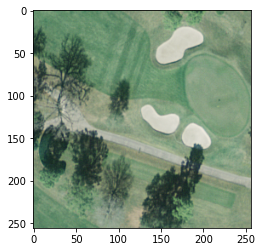

985
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a part of a golf course with green turfs and some trees
Real Caption  2 : a part of a golf course with green turfs and some trees
Real Caption  3 : a part of a golf course with green turfs and some trees
Real Caption  4 : there are turfs and some trees in the golf course
Real Caption  5 : green turfs and some trees in the golf course
Predicted Caption: a part of a golf course with green turfs and some trees


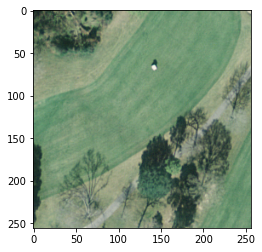

986
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a part of a golf course with green turfs and some bunkers and trees
Real Caption  2 : a part of a golf course with green turfs and some bunkers and trees
Real Caption  3 : a part of a golf course with green turfs and some bunkers
Real Caption  4 : there are turfs and some bunkers and trees in the golf course
Real Caption  5 : green turfs and some bunkers and trees in the golf course
Predicted Caption: a part of a golf course with green turfs and some bunkers and trees


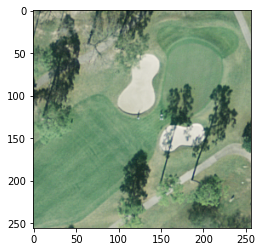

987
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : this is a part of a golf course with green turfs and some bunkers and trees
Real Caption  2 : a part of a golf course with green turfs and some bunkers and trees
Real Caption  3 : a part of a golf course with green turfs and some trees
Real Caption  4 : there are turfs and some bunkers and trees in the golf course
Real Caption  5 : green turfs and some bunkers and trees in the golf course
Predicted Caption: a part of a golf course with green turfs and some trees


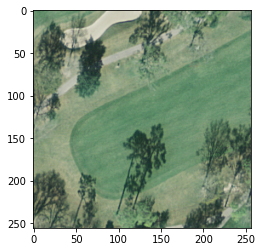

988
BLEU-1 score: 92.85713958740234
BLEU-2 score: 92.5820083618164
BLEU-3 score: 92.27587890625
BLEU-4 score: 91.9322738647461
Real Caption  1 : this is a part of a golf course with green turfs and some bunkers
Real Caption  2 : a part of a golf course with green turfs and some bunkers and a trail go through the turfs
Real Caption  3 : a part of a golf course with green turfs and some bunkers
Real Caption  4 : there are turfs and some bunkers and a trail go through the turfs in the golf course
Real Caption  5 : green turfs and some bunkers and a trail go through the turfs in the golf course
Predicted Caption: a part of a golf course with green turfs and some bunkers and trees


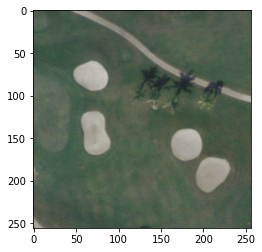

989
BLEU-1 score: 92.85713958740234
BLEU-2 score: 92.5820083618164
BLEU-3 score: 92.27587890625
BLEU-4 score: 91.9322738647461
Real Caption  1 : this is a part of a golf course with green turfs and some bunkers
Real Caption  2 : a part of a golf course with green turfs and some bunkers and a trail go through the turfs
Real Caption  3 : a part of a golf course with green turfs and some bunkers
Real Caption  4 : there are turfs and some bunkers and a trail go through the turfs in the golf course
Real Caption  5 : green turfs and some bunkers and a trail go through the turfs in the golf course
Predicted Caption: a part of a golf course with green turfs and some bunkers and trees


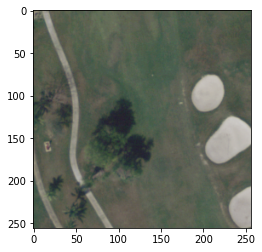

990
BLEU-1 score: 92.85713958740234
BLEU-2 score: 92.5820083618164
BLEU-3 score: 92.27587890625
BLEU-4 score: 91.9322738647461
Real Caption  1 : this is a part of a golf course with green turfs and some bunkers
Real Caption  2 : a part of a golf course with green turfs and some bunkers and a trail go through the turfs
Real Caption  3 : a part of a golf course with green turfs and some bunkers
Real Caption  4 : there are turfs and some bunkers and a trail go through the turfs in the golf course
Real Caption  5 : green turfs and some bunkers and a trail go through the turfs in the golf course
Predicted Caption: a part of a golf course with green turfs and some bunkers and trees


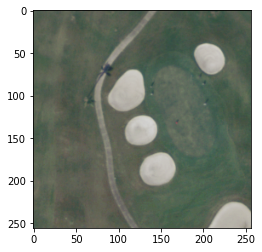

1081
BLEU-1 score: 85.71428680419922
BLEU-2 score: 81.19979858398438
BLEU-3 score: 76.0337142944336
BLEU-4 score: 69.9752197265625
Real Caption  1 : lots of boats docked at the harbor and the water is deep blue
Real Caption  2 : lots of boats docked neatly at the harbor
Real Caption  3 : many boats docked neatly at the harbor and the water is deep blue
Real Caption  4 : many boats docked neatly at the harbor
Real Caption  5 : lots of boats docked neatly at the harbor and the boats are closed to each other
Predicted Caption: many boats docked in lines at the harbor and the water is deep blue


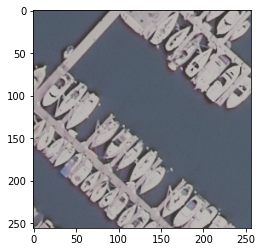

1082
BLEU-1 score: 85.71428680419922
BLEU-2 score: 81.19979858398438
BLEU-3 score: 76.0337142944336
BLEU-4 score: 69.9752197265625
Real Caption  1 : lots of boats docked at the harbor and the water is deep blue
Real Caption  2 : lots of boats docked neatly at the harbor
Real Caption  3 : many boats docked neatly at the harbor and the water is deep blue
Real Caption  4 : many boats docked neatly at the harbor
Real Caption  5 : lots of boats docked neatly at the harbor and the boats are closed to each other
Predicted Caption: many boats docked in lines at the harbor and the water is deep blue


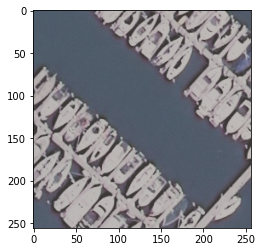

1083
BLEU-1 score: 23.884374618530273
BLEU-2 score: 0.0
BLEU-3 score: 0.0
BLEU-4 score: 0.0
Real Caption  1 : lots of boats docked at the harbor and the water is deep blue
Real Caption  2 : lots of boats docked neatly at the harbor
Real Caption  3 : many boats docked neatly at the harbor and the water is deep blue
Real Caption  4 : many boats docked neatly at the harbor and the boats are closed to each other
Real Caption  5 : lots of boats docked neatly at the harbor
Predicted Caption: there is a piece of farmland


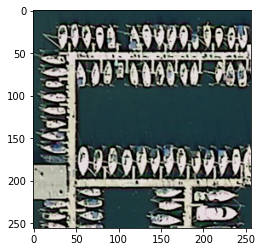

1084
BLEU-1 score: 53.66925048828125
BLEU-2 score: 47.37571716308594
BLEU-3 score: 39.56828689575195
BLEU-4 score: 28.209928512573242
Real Caption  1 : lots of boats docked at the harbor and the water is deep blue
Real Caption  2 : lots of boats docked in lines at the harbor
Real Caption  3 : many boats docked in lines at the harbor and the water is deep blue
Real Caption  4 : many boats docked in lines at the harbor
Real Caption  5 : lots of boats docked in lines at the harbor and the water is deep blue
Predicted Caption: many boats docked neatly at the harbor and some positions are free


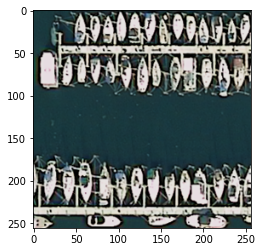

1086
BLEU-1 score: 61.3362922668457
BLEU-2 score: 59.92606735229492
BLEU-3 score: 58.30832290649414
BLEU-4 score: 56.419857025146484
Real Caption  1 : lots of boats with different size docked at the harbor
Real Caption  2 : lots of boats docked neatly at the harbor
Real Caption  3 : many boats docked neatly at the harbor and the water is deep blue
Real Caption  4 : many boats with different size docked neatly at the harbor
Real Caption  5 : lots of boats with different size docked neatly at the harbor
Predicted Caption: many boats docked neatly at the harbor and some positions are free


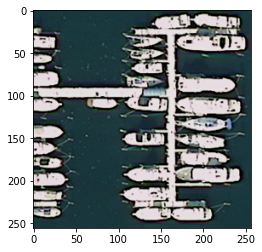

1087
BLEU-1 score: 61.3362922668457
BLEU-2 score: 59.92606735229492
BLEU-3 score: 58.30832290649414
BLEU-4 score: 56.419857025146484
Real Caption  1 : lots of boats with different size docked at the harbor
Real Caption  2 : lots of boats docked neatly at the harbor
Real Caption  3 : many boats docked neatly at the harbor and the water is deep blue
Real Caption  4 : many boats with different size docked neatly at the harbor
Real Caption  5 : lots of boats with different size docked neatly at the harbor
Predicted Caption: many boats docked neatly at the harbor and some positions are free


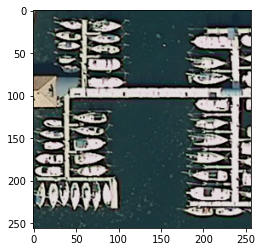

1088
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : lots of boats docked at the harbor and the water is deep blue
Real Caption  2 : lots of boats docked in lines at the harbor
Real Caption  3 : many boats docked in lines at the harbor and the water is deep blue
Real Caption  4 : many boats docked in lines at the harbor and only a few positions are free
Real Caption  5 : lots of boats docked in lines at the harbor and only a few positions are free
Predicted Caption: lots of boats docked in lines at the harbor


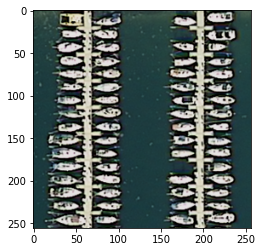

1089
BLEU-1 score: 76.67036437988281
BLEU-2 score: 66.9993896484375
BLEU-3 score: 54.87023162841797
BLEU-4 score: 36.049076080322266
Real Caption  1 : lots of boats docked at the harbor and the water is deep blue
Real Caption  2 : lots of boats docked in lines at the harbor
Real Caption  3 : many boats docked in lines at the harbor and the water is deep blue
Real Caption  4 : many boats docked in lines at the harbor and only a few positions are free
Real Caption  5 : lots of boats docked in lines at the harbor and only a few positions are free
Predicted Caption: many boats docked neatly at the harbor and some positions are free


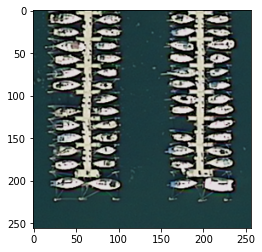

1090
BLEU-1 score: 92.85713958740234
BLEU-2 score: 88.6405258178711
BLEU-3 score: 83.83820343017578
BLEU-4 score: 78.25422668457031
Real Caption  1 : lots of boats docked at the harbor and the water is deep blue
Real Caption  2 : lots of boats docked in lines at the harbor
Real Caption  3 : many boats docked in lines at the harbor and the water is deep blue
Real Caption  4 : many boats docked in lines at the harbor and only a few positions are free
Real Caption  5 : lots of boats docked in lines at the harbor and only a few positions are free
Predicted Caption: lots of boats docked neatly at the harbor and the water is deep blue


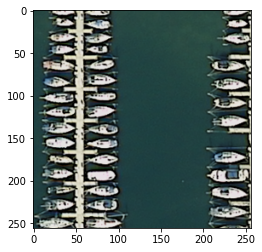

1181
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : an intersection with some cars on the road
Real Caption  2 : an intersection with some houses and plants at the corners
Real Caption  3 : an intersection with some houses and plants at the corners
Real Caption  4 : an intersection with two roads vertical to each other
Real Caption  5 : an intersection with two roads vertical to each other
Predicted Caption: an intersection with some houses and plants at the corners


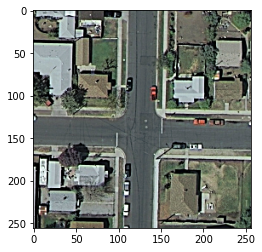

1182
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : an intersection with some cars on the road
Real Caption  2 : an intersection with some houses and plants at the corners
Real Caption  3 : an intersection with some houses and plants at the corners
Real Caption  4 : an intersection with two roads vertical to each other
Real Caption  5 : an intersection with two roads vertical to each other
Predicted Caption: an intersection with some houses and plants at the corners


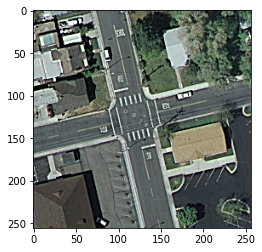

1183
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : an intersection with some cars on the road
Real Caption  2 : an intersection with some houses and plants at the corners
Real Caption  3 : an intersection with some houses and plants at the corners
Real Caption  4 : an intersection with two roads vertical to each other
Real Caption  5 : an intersection with two roads vertical to each other
Predicted Caption: an intersection with some cars on the road


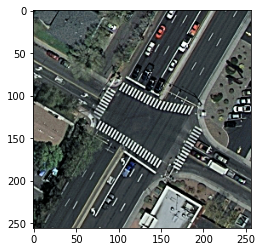

1184
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : an intersection with some cars on the road
Real Caption  2 : an intersection with some houses and plants at the corners
Real Caption  3 : an intersection with some houses and plants at the corners
Real Caption  4 : an intersection with two roads vertical to each other
Real Caption  5 : an intersection with two roads vertical to each other
Predicted Caption: an intersection with two roads vertical to each other


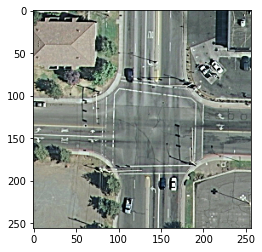

1185
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : an intersection with no cars or pedestrians
Real Caption  2 : an intersection with some plants at the corners
Real Caption  3 : a desolate intersection only with some plants at the corners
Real Caption  4 : a desolate intersection with no cars or pedestrians
Real Caption  5 : an intersection with two roads vertical to each other
Predicted Caption: an intersection with two roads vertical to each other


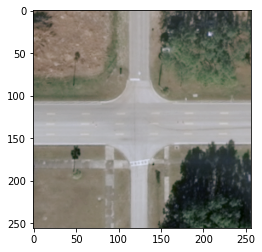

1186
BLEU-1 score: 55.55555725097656
BLEU-2 score: 37.267799377441406
BLEU-3 score: 27.072174072265625
BLEU-4 score: 0.0
Real Caption  1 : an intersection with many cars on the road
Real Caption  2 : an intersection with some plants at the corners
Real Caption  3 : a busy intersection only with some plants at the corners
Real Caption  4 : a busy intersection with two roads are not vertical to each other
Real Caption  5 : an intersection with two roads are not vertical to each other
Predicted Caption: there are two straight freeways closed to each other


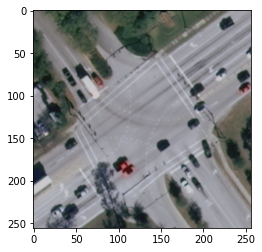

1187
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : an intersection with a few cars on the road
Real Caption  2 : an intersection with some houses and plants at the corners
Real Caption  3 : an intersection only with some houses and plants at the corners
Real Caption  4 : an intersection with two roads vertical to each other
Real Caption  5 : an intersection with two roads vertical to each other
Predicted Caption: an intersection with two roads vertical to each other


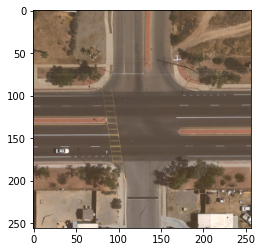

1188
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : an intersection with a few cars on the road
Real Caption  2 : an intersection with some houses and plants at the corners
Real Caption  3 : an intersection only with some houses and plants at the corners
Real Caption  4 : an intersection with two roads vertical to each other
Real Caption  5 : an intersection with two roads vertical to each other
Predicted Caption: an intersection with two roads vertical to each other


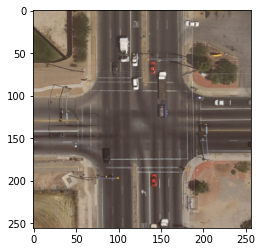

1189
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : an intersection with no cars or pedestrians
Real Caption  2 : an intersection with four houses at each corner
Real Caption  3 : a desolate intersection only with four houses at each corner
Real Caption  4 : a desolate intersection with no cars or pedestrians
Real Caption  5 : an intersection with two roads vertical to each other
Predicted Caption: an intersection with two roads vertical to each other


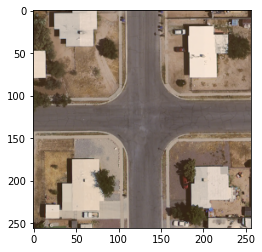

1281
BLEU-1 score: 54.54545593261719
BLEU-2 score: 46.709938049316406
BLEU-3 score: 41.74127960205078
BLEU-4 score: 36.72056198120117
Real Caption  1 : it is a medium residential area
Real Caption  2 : a medium residential area with houses surrounded by lawn
Real Caption  3 : a medium residential area with houses surrounded by lawn
Real Caption  4 : many houses with lawn surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with houses surrounded by lawn
Predicted Caption: a medium residential area with a road goes through this area


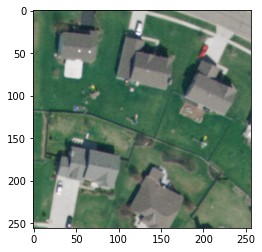

1282
BLEU-1 score: 54.54545593261719
BLEU-2 score: 46.709938049316406
BLEU-3 score: 41.74127960205078
BLEU-4 score: 36.72056198120117
Real Caption  1 : it is a medium residential area
Real Caption  2 : a medium residential area with houses and plants
Real Caption  3 : a medium residential area with houses surrounded by plants
Real Caption  4 : many houses with plants surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with houses
Predicted Caption: a medium residential area with a road goes through this area


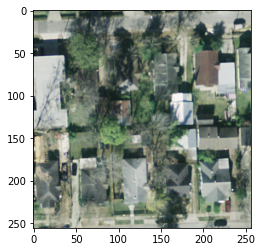

1283
BLEU-1 score: 61.5384635925293
BLEU-2 score: 55.47002029418945
BLEU-3 score: 51.90764236450195
BLEU-4 score: 48.63383102416992
Real Caption  1 : it is a medium residential area
Real Caption  2 : a medium residential area with houses and plants
Real Caption  3 : a medium residential area with houses surrounded by plants
Real Caption  4 : many houses with plants surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with houses
Predicted Caption: it is a medium residential area with a road goes through this area


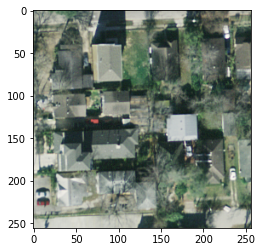

1284
BLEU-1 score: 54.54545593261719
BLEU-2 score: 33.02891159057617
BLEU-3 score: 22.97110939025879
BLEU-4 score: 0.0
Real Caption  1 : it is a medium residential area with houses arranged neatly
Real Caption  2 : a medium residential area with houses and plants
Real Caption  3 : a medium residential area with a road goes through this area
Real Caption  4 : some houses with plants surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with houses surrounded by plants
Predicted Caption: lots of houses arranged neatly and some roads go through them


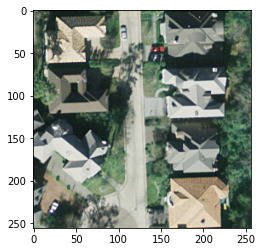

1285
BLEU-1 score: 45.45454788208008
BLEU-2 score: 36.92744827270508
BLEU-3 score: 31.176593780517578
BLEU-4 score: 24.808414459228516
Real Caption  1 : it is a medium residential area with houses and plants
Real Caption  2 : a medium residential area with houses arranged neatly
Real Caption  3 : a medium residential area with houses arranged neatly and a road goes through
Real Caption  4 : many houses arranged neatly with plants surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with a road goes through
Predicted Caption: lots of houses arranged neatly and some roads go through them


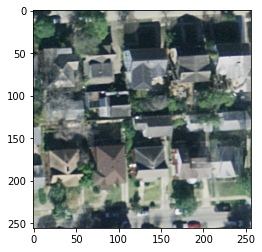

1286
BLEU-1 score: 45.45454788208008
BLEU-2 score: 36.92744827270508
BLEU-3 score: 31.176593780517578
BLEU-4 score: 24.808414459228516
Real Caption  1 : it is a medium residential area with houses and plants
Real Caption  2 : a medium residential area with houses arranged neatly
Real Caption  3 : a medium residential area with houses arranged neatly and a road goes through
Real Caption  4 : many houses arranged neatly with plants surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with a road goes through
Predicted Caption: lots of houses arranged neatly and some roads go through them


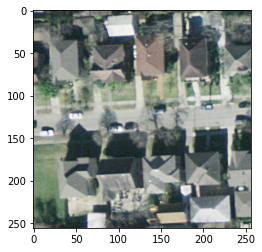

1287
BLEU-1 score: 54.54545593261719
BLEU-2 score: 46.709938049316406
BLEU-3 score: 41.74127960205078
BLEU-4 score: 36.72056198120117
Real Caption  1 : it is a medium residential area
Real Caption  2 : a medium residential area with houses and plants flourish
Real Caption  3 : a medium residential area with houses suttounded by plants
Real Caption  4 : many houses with plants surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with houses surrounded by plants
Predicted Caption: a medium residential area with a road goes through this area


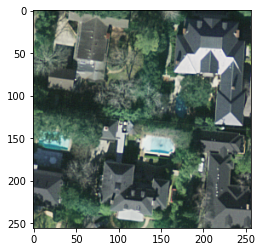

1288
BLEU-1 score: 58.33333206176758
BLEU-2 score: 46.056617736816406
BLEU-3 score: 34.87691116333008
BLEU-4 score: 0.0
Real Caption  1 : it is a medium residential area
Real Caption  2 : a medium residential area with houses and plants flourish
Real Caption  3 : a medium residential area with houses suttounded by plants
Real Caption  4 : many houses with plants surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with houses surrounded by plants
Predicted Caption: it is a dense residential area with lots of houses arranged neatly


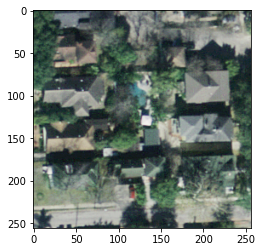

1289
BLEU-1 score: 91.31006622314453
BLEU-2 score: 86.62432861328125
BLEU-3 score: 81.07456970214844
BLEU-4 score: 74.26140594482422
Real Caption  1 : it is a medium residential area
Real Caption  2 : a medium residential area with houses sorrounded by plants
Real Caption  3 : a medium residential area with a narrow road goes through this area
Real Caption  4 : some houses with plants surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with houses and plants and a narrow road goes through
Predicted Caption: a medium residential area with a road goes through this area


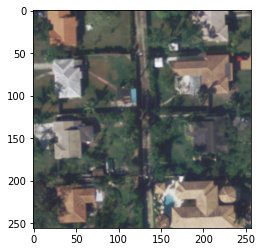

1290
BLEU-1 score: 91.31006622314453
BLEU-2 score: 86.62432861328125
BLEU-3 score: 81.07456970214844
BLEU-4 score: 74.26140594482422
Real Caption  1 : it is a medium residential area
Real Caption  2 : a medium residential area with houses sorrounded by plants
Real Caption  3 : a medium residential area with a narrow road goes through this area
Real Caption  4 : some houses with plants surrounded in the medium residential area
Real Caption  5 : this is a medium residential area with houses and plants and a narrow road goes through
Predicted Caption: a medium residential area with a road goes through this area


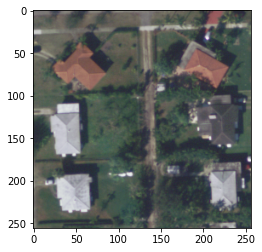

1381
BLEU-1 score: 91.31006622314453
BLEU-2 score: 91.31006622314453
BLEU-3 score: 91.31006622314453
BLEU-4 score: 91.31006622314453
Real Caption  1 : many mobile homes arranged in lines with some cars parked at the roadside in the mobile home park
Real Caption  2 : many mobile homes are closed to each other in the mobile home park
Real Caption  3 : lots of mobile homes with plants surrounded in the mobile home park
Real Caption  4 : many mobile homes arranged in lines in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes are closed to each other and some roads go through this area
Predicted Caption: many mobile homes arranged in lines in the mobile home park


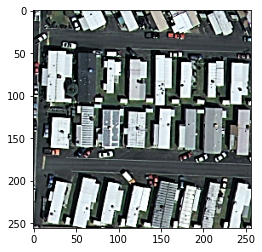

1382
BLEU-1 score: 91.31006622314453
BLEU-2 score: 91.31006622314453
BLEU-3 score: 91.31006622314453
BLEU-4 score: 91.31006622314453
Real Caption  1 : many mobile homes arranged in lines with some cars parked at the roadside in the mobile home park
Real Caption  2 : many mobile homes are closed to each other in the mobile home park
Real Caption  3 : lots of mobile homes with plants surrounded in the mobile home park
Real Caption  4 : many mobile homes arranged in lines in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes are closed to each other and some roads go through this area
Predicted Caption: many mobile homes arranged in lines in the mobile home park


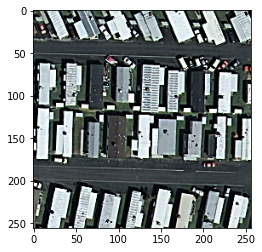

1383
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : many mobile homes arranged neatly in the mobile home park
Real Caption  2 : many mobile homes are closed to each other in the mobile home park
Real Caption  3 : lots of mobile homes with plants surrounded in the mobile home park
Real Caption  4 : many mobile homes arranged neatly in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes are closed to each other and some roads go through this area
Predicted Caption: many mobile homes arranged neatly in the mobile home park


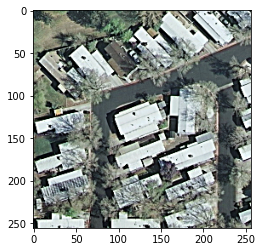

1384
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : many mobile homes arranged neatly in the mobile home park
Real Caption  2 : many mobile homes are closed to each other in the mobile home park
Real Caption  3 : lots of mobile homes with plants surrounded in the mobile home park
Real Caption  4 : many mobile homes arranged neatly in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes are closed to each other and some roads go through this area
Predicted Caption: many mobile homes arranged neatly in the mobile home park


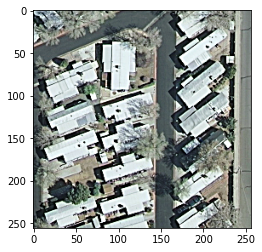

1385
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : many mobile homes arranged neatly in the mobile home park
Real Caption  2 : many mobile homes are closed to each other in the mobile home park
Real Caption  3 : lots of mobile homes with plants surrounded in the mobile home park
Real Caption  4 : many mobile homes arranged neatly in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes are closed to each other and some roads go through this area
Predicted Caption: many mobile homes arranged neatly in the mobile home park


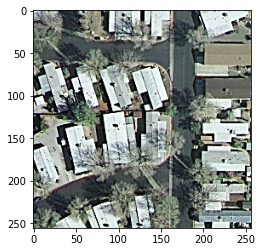

1386
BLEU-1 score: 85.47332000732422
BLEU-2 score: 81.212158203125
BLEU-3 score: 76.29756164550781
BLEU-4 score: 67.340087890625
Real Caption  1 : many mobile homes arranged in lines in the mobile home park
Real Caption  2 : many mobile homes are very closed to each other in the mobile home park
Real Caption  3 : lots of mobile homes with plants surrounded in the mobile home park
Real Caption  4 : many mobile homes arranged in lines in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes are very closed to each other and some roads go through this area
Predicted Caption: lots of mobile homes arranged neatly and some roads go through this area


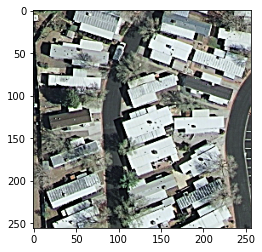

1387
BLEU-1 score: 72.7272720336914
BLEU-2 score: 60.302268981933594
BLEU-3 score: 49.48976135253906
BLEU-4 score: 41.72261428833008
Real Caption  1 : many mobile homes arranged in lines in the mobile home park
Real Caption  2 : many mobile homes are very closed to each other in the mobile home park
Real Caption  3 : lots of mobile homes with plants surrounded in the mobile home park
Real Caption  4 : many mobile homes arranged in lines in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes are very closed to each other and some roads go through this area
Predicted Caption: lots of houses arranged neatly and some roads go through them


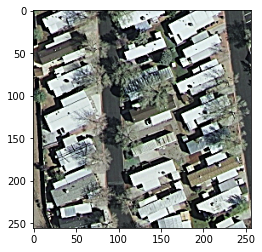

1388
BLEU-1 score: 81.43535614013672
BLEU-2 score: 75.7041244506836
BLEU-3 score: 68.69047546386719
BLEU-4 score: 59.541648864746094
Real Caption  1 : many mobile homes arranged in lines in the mobile home park
Real Caption  2 : many mobile homes are very closed to each other in the mobile home park
Real Caption  3 : lots of mobile homes with plants surrounded in the mobile home park
Real Caption  4 : many mobile homes arranged in lines in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes are very closed to each other and some roads go through this area
Predicted Caption: many mobile homes arranged neatly in the mobile home park


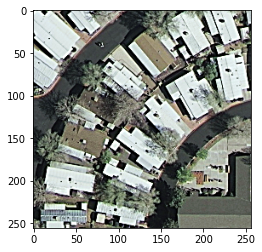

1389
BLEU-1 score: 90.90909576416016
BLEU-2 score: 85.28028869628906
BLEU-3 score: 78.56010437011719
BLEU-4 score: 70.1688003540039
Real Caption  1 : many mobile homes are arranged haphazardly in the mobile home park
Real Caption  2 : many mobile homes are arranged haphazardly with some cars parked at the roadside in the mobile home park
Real Caption  3 : lots of mobile homes with some cars parked at the roadside in the mobile home park
Real Caption  4 : many mobile homes arranged haphazardly in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes arranged haphazardly and some roads go through this area
Predicted Caption: lots of mobile homes arranged neatly in the mobile home park


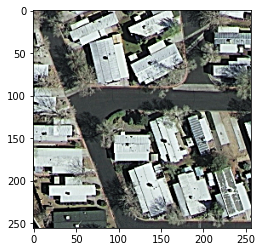

1390
BLEU-1 score: 36.3636360168457
BLEU-2 score: 26.967992782592773
BLEU-3 score: 20.06711196899414
BLEU-4 score: 0.0
Real Caption  1 : many mobile homes are arranged haphazardly in the mobile home park
Real Caption  2 : many mobile homes are arranged haphazardly with some cars parked at the roadside in the mobile home park
Real Caption  3 : lots of mobile homes with some cars parked at the roadside in the mobile home park
Real Caption  4 : many mobile homes arranged haphazardly in the mobile home park and some roads go through this area
Real Caption  5 : lots of mobile homes arranged haphazardly and some roads go through this area
Predicted Caption: a medium residential area with a road goes through this area


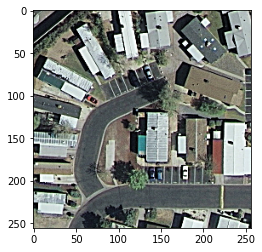

1481
BLEU-1 score: 81.43535614013672
BLEU-2 score: 63.98166275024414
BLEU-3 score: 51.78900909423828
BLEU-4 score: 43.53152084350586
Real Caption  1 : a road go across another two roads vertically
Real Caption  2 : a road go across another two roads vertically with some cars on the roads
Real Caption  3 : a road go across another two roads vertically with lawn surounded
Real Caption  4 : an overpass cross two roads vertically with some cars on the roads
Real Caption  5 : an overpass go across two roads with some cars on the roads and surrounded by lawn
Predicted Caption: an overpass with a road go across another roads diagonally


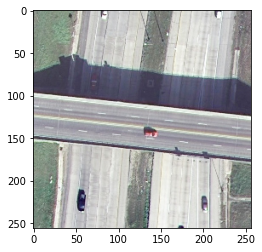

1482
BLEU-1 score: 81.8730697631836
BLEU-2 score: 72.20526123046875
BLEU-3 score: 68.40901184082031
BLEU-4 score: 65.7791519165039
Real Caption  1 : a road go across another one diagonally
Real Caption  2 : an overpass with a road go across another one diagonally with no cars on the roads
Real Caption  3 : an overpass with a road go across another one diagonally with some plants surounded
Real Caption  4 : a road go across another one diagonally with no cars on the roads
Real Caption  5 : a road go across another one with no cars on the roads
Predicted Caption: an overpass with a road go across another roads diagonally


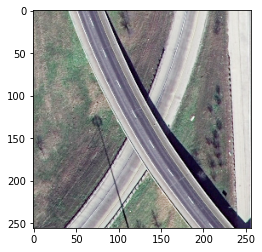

1483
BLEU-1 score: 81.8730697631836
BLEU-2 score: 72.20526123046875
BLEU-3 score: 68.40901184082031
BLEU-4 score: 65.7791519165039
Real Caption  1 : a road go across another one diagonally
Real Caption  2 : an overpass with a road go across another one diagonally with no cars on the roads
Real Caption  3 : an overpass with a road go across another one diagonally with some plants surounded
Real Caption  4 : a road go across another one diagonally with no cars on the roads
Real Caption  5 : a road go across another one with no cars on the roads
Predicted Caption: an overpass with a road go across another roads diagonally


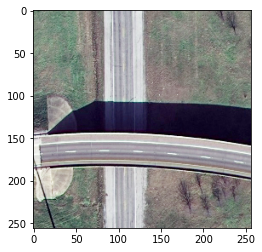

1484
BLEU-1 score: 100.0
BLEU-2 score: 88.19171142578125
BLEU-3 score: 78.62822723388672
BLEU-4 score: 72.59795379638672
Real Caption  1 : a road go across another roads diagonally
Real Caption  2 : an overpass cross the roads diagonally with some cars on the roads
Real Caption  3 : a road go across another roads diagonally with lawn surounded
Real Caption  4 : an overpass cross the roads diagonally with some cars on the roads
Real Caption  5 : an overpass go across the roads with some cars on the roads
Predicted Caption: an overpass with a road go across another roads diagonally


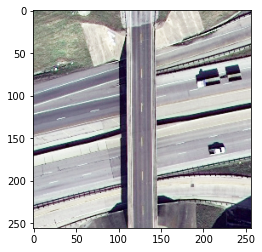

1485
BLEU-1 score: 90.48373413085938
BLEU-2 score: 73.8796615600586
BLEU-3 score: 57.00118637084961
BLEU-4 score: 46.77766418457031
Real Caption  1 : a road go across another one diagonally
Real Caption  2 : an overpass cross the roads diagonally with no cars on the roads
Real Caption  3 : a road go across another one diagonally with some plants surounded
Real Caption  4 : a road go across another one diagonally with no cars on the roads
Real Caption  5 : an overpass go across the roads with no cars on the roads
Predicted Caption: an overpass with a road go across another roads diagonally


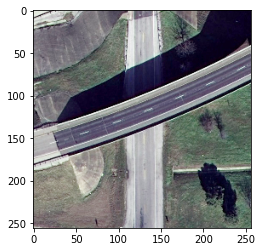

1486
BLEU-1 score: 90.48373413085938
BLEU-2 score: 79.79915618896484
BLEU-3 score: 75.6036605834961
BLEU-4 score: 72.69720458984375
Real Caption  1 : a road go across another one diagonally
Real Caption  2 : an overpass with a road go across another one diagonally with one car on the roads
Real Caption  3 : a road go across another one diagonally with some plants surounded
Real Caption  4 : a road go across another one diagonally with one car on the roads
Real Caption  5 : an overpass with a road go across another one and one car on the roads
Predicted Caption: an overpass with a road go across another roads diagonally


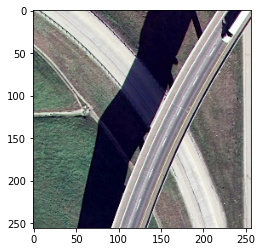

1487
BLEU-1 score: 90.48373413085938
BLEU-2 score: 79.79915618896484
BLEU-3 score: 75.6036605834961
BLEU-4 score: 72.69720458984375
Real Caption  1 : a road go across another one diagonally
Real Caption  2 : an overpass with a road go across another one diagonally with one car on the roads
Real Caption  3 : a road go across another one diagonally with some plants surounded
Real Caption  4 : a road go across another one diagonally with one car on the roads
Real Caption  5 : an overpass with a road go across another one and one car on the roads
Predicted Caption: an overpass with a road go across another roads diagonally


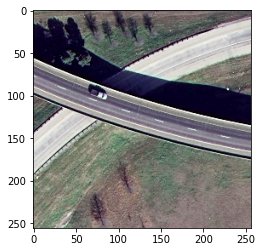

1488
BLEU-1 score: 63.33861541748047
BLEU-2 score: 43.707801818847656
BLEU-3 score: 0.0
BLEU-4 score: 0.0
Real Caption  1 : an overpass go across the roads diagonally
Real Caption  2 : an overpass cross the roads diagonally with some cars on the roads
Real Caption  3 : an overpass go across the roads diagonally with some plants surounded
Real Caption  4 : an overpass cross the roads diagonally with some cars on the roads
Real Caption  5 : an overpass go across the roads with some cars on the roads
Predicted Caption: an overpass with a road go across another roads diagonally


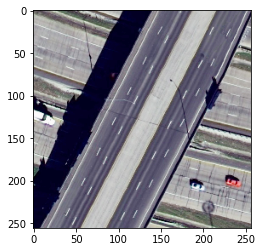

1489
BLEU-1 score: 90.48373413085938
BLEU-2 score: 79.79915618896484
BLEU-3 score: 71.14575958251953
BLEU-4 score: 61.13081741333008
Real Caption  1 : a narrow road go across another one diagonally
Real Caption  2 : an overpass with a narrow road go across another one diagonally and some cars on the roads
Real Caption  3 : a road go across another one diagonally with some plants surounded
Real Caption  4 : a road go across another one diagonally with some cars on the roads
Real Caption  5 : an overpass go across the roads with some cars on the roads
Predicted Caption: an overpass with a road go across another roads diagonally


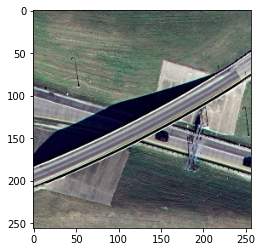

1490
BLEU-1 score: 90.48373413085938
BLEU-2 score: 79.79915618896484
BLEU-3 score: 71.14575958251953
BLEU-4 score: 61.13081741333008
Real Caption  1 : a narrow road go across another one diagonally
Real Caption  2 : an overpass with a narrow road go across another one diagonally and some cars on the roads
Real Caption  3 : a road go across another one diagonally with some plants surounded
Real Caption  4 : a road go across another one diagonally with some cars on the roads
Real Caption  5 : an overpass go across the roads with some cars on the roads
Predicted Caption: an overpass with a road go across another roads diagonally


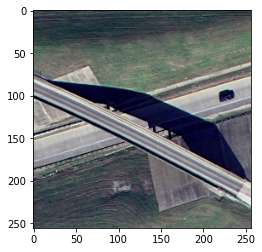

1581
BLEU-1 score: 88.8888931274414
BLEU-2 score: 81.649658203125
BLEU-3 score: 72.49202728271484
BLEU-4 score: 59.694923400878906
Real Caption  1 : lots of cars are very closed to each other in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars are densely arranged in the parking lot
Real Caption  4 : it is a parking lot with many cars densely arranged
Real Caption  5 : many cars densely arranged in the parking lot
Predicted Caption: lots of cars parked neatly in the parking lot


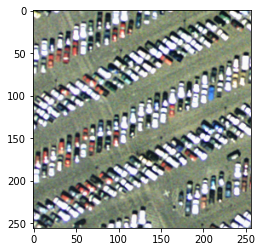

1582
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : lots of cars are very closed to each other in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars are densely arranged in the parking lot
Real Caption  4 : it is a parking lot with many cars densely arranged
Real Caption  5 : many cars densely arranged in the parking lot
Predicted Caption: lots of cars parked in lines in the parking lot


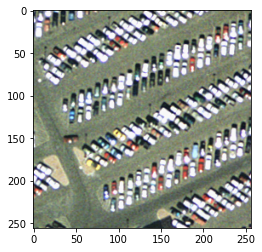

1583
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : lots of cars are very closed to each other in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars are densely arranged in the parking lot
Real Caption  4 : it is a parking lot with many cars densely arranged
Real Caption  5 : many cars densely arranged in the parking lot
Predicted Caption: lots of cars parked in lines in the parking lot


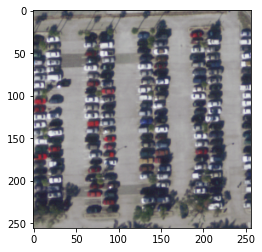

1584
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : lots of cars are very closed to each other in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars are densely arranged in the parking lot
Real Caption  4 : it is a parking lot with many cars densely arranged
Real Caption  5 : many cars densely arranged in the parking lot
Predicted Caption: lots of cars parked in lines in the parking lot


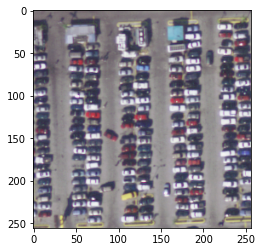

1585
BLEU-1 score: 88.8888931274414
BLEU-2 score: 81.649658203125
BLEU-3 score: 72.49202728271484
BLEU-4 score: 59.694923400878906
Real Caption  1 : lots of cars are very closed to each other in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars are densely arranged in the parking lot
Real Caption  4 : it is a parking lot with many cars densely arranged
Real Caption  5 : many cars densely arranged in the parking lot
Predicted Caption: lots of cars parked neatly in the parking lot


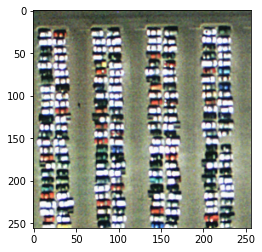

1586
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : lots of cars are very closed to each other in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars are densely arranged in the parking lot
Real Caption  4 : it is a parking lot with many cars densely arranged
Real Caption  5 : many cars densely arranged in the parking lot
Predicted Caption: lots of cars parked in lines in the parking lot


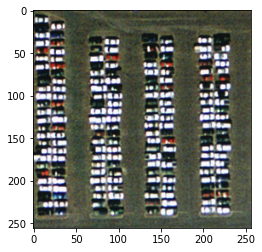

1587
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : lots of cars are very closed to each other in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars are densely arranged in the parking lot
Real Caption  4 : it is a parking lot with many cars densely arranged
Real Caption  5 : many cars densely arranged in the parking lot
Predicted Caption: lots of cars parked in lines in the parking lot


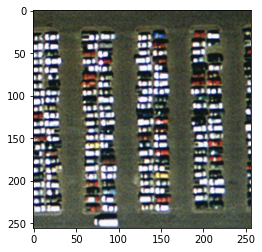

1588
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : lots of cars parked neatly in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars parked neatly with many empty parking spaces in the parking lot
Real Caption  4 : it is a parking lot with many cars parked neatly and many parking spots are free
Real Caption  5 : many cars parked in lines with many free parking spots in the parking lot
Predicted Caption: lots of cars parked in lines in the parking lot


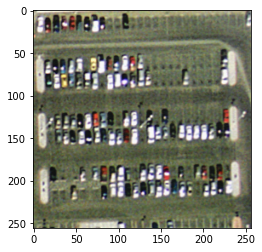

1589
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : lots of cars are densely arranged in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars arranged in lines in the parking lot
Real Caption  4 : it is a parking lot with many cars densely arranged
Real Caption  5 : many cars densely arranged in the parking lot
Predicted Caption: lots of cars parked in lines in the parking lot


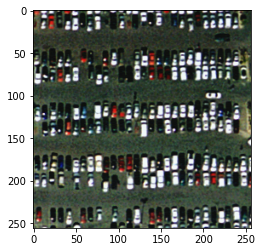

1590
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : lots of cars are densely arranged in the parking lot
Real Caption  2 : lots of cars parked in lines in the parking lot
Real Caption  3 : many cars arranged in lines in the parking lot
Real Caption  4 : it is a parking lot with many cars densely arranged
Real Caption  5 : many cars densely arranged in the parking lot
Predicted Caption: lots of cars parked in lines in the parking lot


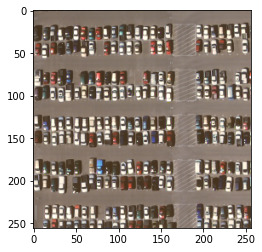

1681
BLEU-1 score: 50.0
BLEU-2 score: 36.92744827270508
BLEU-3 score: 23.89091682434082
BLEU-4 score: 0.0
Real Caption  1 : it is a river with some plants on one bank and roads on the other side
Real Caption  2 : a river with a forest on one bank and roads on the other side
Real Caption  3 : green plants flourish on one bank of the river
Real Caption  4 : lots of green plants flourish on one bank of the river
Real Caption  5 : a river goes through this area with dense forest on one bank and roads on the other side
Predicted Caption: it is a straight runway with some white mark lines on it


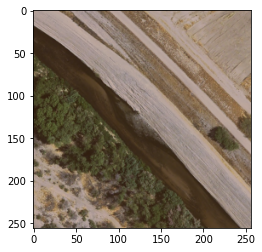

1682
BLEU-1 score: 94.11764526367188
BLEU-2 score: 87.44746398925781
BLEU-3 score: 82.46417236328125
BLEU-4 score: 77.48677825927734
Real Caption  1 : it is a river with some plants on one bank and roads on the other side
Real Caption  2 : a river with a forest on one bank and roads on the other side
Real Caption  3 : green plants flourish on one bank of the river
Real Caption  4 : lots of green plants flourish on one bank of the river
Real Caption  5 : a river goes through this area with dense forest on one bank and roads on the other side
Predicted Caption: it is a river with some plants on one bank and a road on the other side


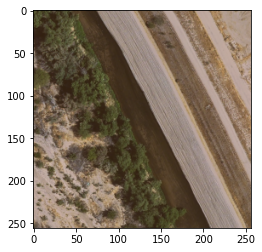

1683
BLEU-1 score: 71.22776794433594
BLEU-2 score: 70.331787109375
BLEU-3 score: 62.98225402832031
BLEU-4 score: 51.326560974121094
Real Caption  1 : it is a river with some plants on one bank and sands on the other side
Real Caption  2 : a river with a forest on one bank and sands on the other side
Real Caption  3 : green plants flourish on one bank of the river
Real Caption  4 : lots of green plants flourish on one bank of the river
Real Caption  5 : a river goes through this area with dense forest on one bank and sands on the other side
Predicted Caption: it is a river with dense forest on both banks of the river


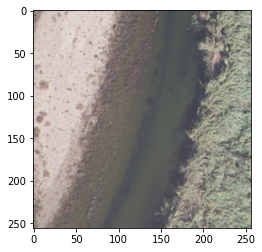

1684
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a river with some plants on both banks of the river
Real Caption  2 : a river with some plants on both banks of the river
Real Caption  3 : some plants on both banks of the river
Real Caption  4 : some plants are on both banks of the river
Real Caption  5 : a river go through the area with some plants
Predicted Caption: it is a river with some plants on both banks of the river


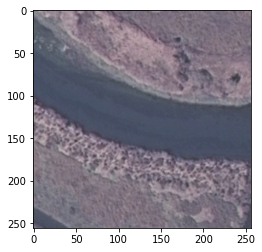

1685
BLEU-1 score: 41.666664123535156
BLEU-2 score: 27.524093627929688
BLEU-3 score: 19.640024185180664
BLEU-4 score: 0.0
Real Caption  1 : it is a very wide river with dense forest on both banks of the river
Real Caption  2 : a wide river with dense forest on both banks of the river
Real Caption  3 : green plants flourish on both banks of the wide river
Real Caption  4 : lots of green plants flourish on both banks of the wide river
Real Caption  5 : a very wide river go through a dense forest
Predicted Caption: it is a straight runway with some white mark lines on it


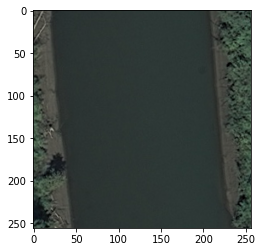

1686
BLEU-1 score: 40.43537902832031
BLEU-2 score: 31.321107864379883
BLEU-3 score: 24.59361457824707
BLEU-4 score: 0.0
Real Caption  1 : it is a very wide river with dense forest on both banks of the river
Real Caption  2 : a wide river with dense forest on both banks of the river
Real Caption  3 : green plants flourish on both banks of the wide river
Real Caption  4 : lots of green plants flourish on both banks of the wide river
Real Caption  5 : a very wide river go through a dense forest
Predicted Caption: it is a piece of farmland


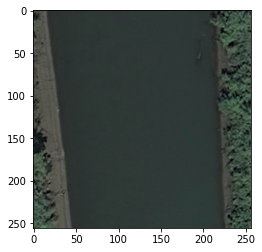

1687
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a river with dense forest on both banks of the river
Real Caption  2 : a river with dense forest on both banks of the river
Real Caption  3 : green plants flourish on both banks of the river
Real Caption  4 : lots of green plants flourish on both banks of the river
Real Caption  5 : a river go through a dense forest
Predicted Caption: lots of green plants flourish on both banks of the river


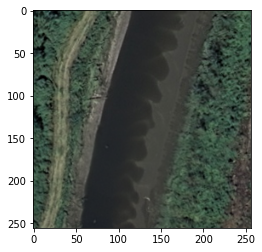

1688
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a river with dense forest on both banks of the river
Real Caption  2 : a river with dense forest on both banks of the river
Real Caption  3 : green plants flourish on both banks of the river
Real Caption  4 : lots of green plants flourish on both banks of the river
Real Caption  5 : a river go through a dense forest
Predicted Caption: lots of green plants flourish on both banks of the river


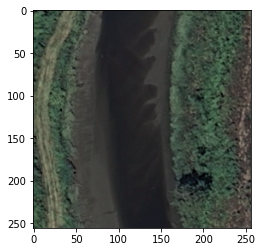

1689
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a river with dense forest on both banks of the river
Real Caption  2 : a river with dense forest on both banks of the river
Real Caption  3 : green plants flourish on both banks of the river
Real Caption  4 : lots of green plants flourish on both banks of the river
Real Caption  5 : a river go through a dense forest
Predicted Caption: green plants flourish on both banks of the river


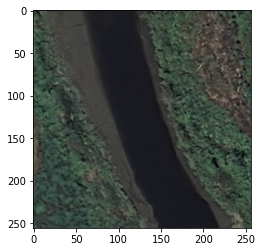

1690
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a river with dense forest on both banks of the river
Real Caption  2 : a river with dense forest on both banks of the river
Real Caption  3 : green plants flourish on both banks of the river
Real Caption  4 : lots of green plants flourish on both banks of the river
Real Caption  5 : a river go through a dense forest
Predicted Caption: lots of green plants flourish on both banks of the river


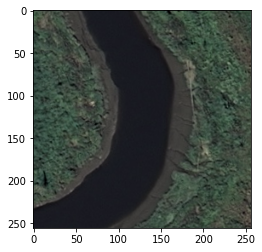

1781
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a straight runway with some mark lines on it
Real Caption  2 : a straight runway with some mark lines on it
Real Caption  3 : there are some mark lines on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines on it
Real Caption  5 : a straight runway with some white mark lines on it
Predicted Caption: it is a straight runway with some white mark lines on it


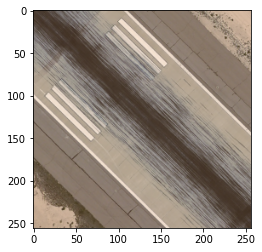

1782
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a straight runway with some mark lines on it
Real Caption  2 : a straight runway with some mark lines on it
Real Caption  3 : there are some mark lines on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines on it
Real Caption  5 : a straight runway with some white mark lines on it
Predicted Caption: a straight runway with some white mark lines on it


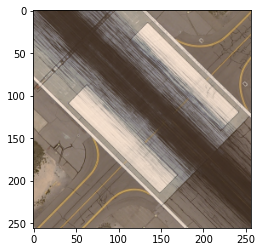

1783
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a straight runway with some mark lines on it
Real Caption  2 : a straight runway with some mark lines on it
Real Caption  3 : there are some mark lines on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines on it
Real Caption  5 : a straight runway with some white mark lines on it
Predicted Caption: a straight runway with some white mark lines on it


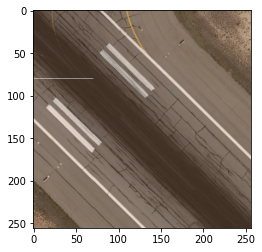

1784
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a straight runway with some mark lines on it
Real Caption  2 : a straight runway with some mark lines on it
Real Caption  3 : there are some mark lines on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines on it
Real Caption  5 : a straight runway with some white mark lines on it
Predicted Caption: a straight runway with some white mark lines on it


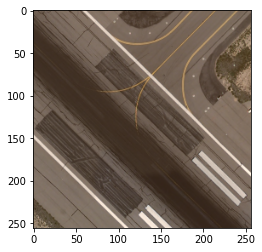

1785
BLEU-1 score: 94.73684692382812
BLEU-2 score: 91.76629638671875
BLEU-3 score: 88.5146484375
BLEU-4 score: 86.63975524902344
Real Caption  1 : it is a straight runway with some mark lines and a number and a letter r on it
Real Caption  2 : a straight runway with some mark lines and a number and a number and a letter r on it
Real Caption  3 : there are some mark lines and a number and a number and a letter r on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines and a number and a number and a letter r on it
Real Caption  5 : a straight runway with some white mark lines and a number and a number and a letter r on it
Predicted Caption: a straight runway with some white mark lines and a number and a number and a number on it


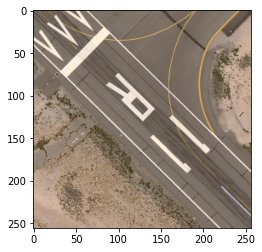

1786
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a straight runway with some mark lines on it
Real Caption  2 : a straight runway with some mark lines on it
Real Caption  3 : there are some mark lines on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines on it
Real Caption  5 : a straight runway with some white mark lines on it
Predicted Caption: a straight runway with some white mark lines on it


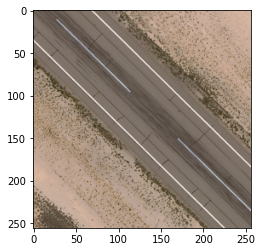

1787
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a straight runway with some mark lines on it
Real Caption  2 : a straight runway with some mark lines on it
Real Caption  3 : there are some mark lines on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines on it
Real Caption  5 : a straight runway with some white mark lines on it
Predicted Caption: a straight runway with some white mark lines on it


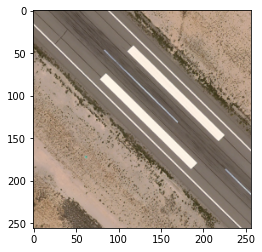

1788
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a straight runway with some mark lines on it
Real Caption  2 : a straight runway with some mark lines on it
Real Caption  3 : there are some mark lines on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines on it
Real Caption  5 : a straight runway with some white mark lines on it
Predicted Caption: a straight runway with some white mark lines on it


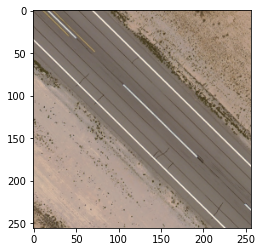

1789
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a straight runway with some mark lines on it
Real Caption  2 : a straight runway with some mark lines on it
Real Caption  3 : there are some mark lines on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines on it
Real Caption  5 : a straight runway with some white mark lines on it
Predicted Caption: a straight runway with some white mark lines on it


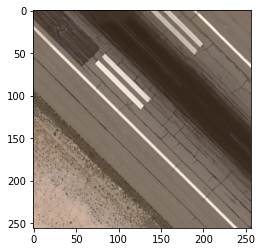

1790
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : it is a straight runway with some mark lines on it
Real Caption  2 : a straight runway with some mark lines on it
Real Caption  3 : there are some mark lines on the straight runway
Real Caption  4 : it is a straight runway with some white mark lines on it
Real Caption  5 : a straight runway with some white mark lines on it
Predicted Caption: a straight runway with some white mark lines on it


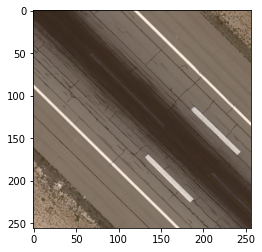

1881
BLEU-1 score: 87.5
BLEU-2 score: 80.1041030883789
BLEU-3 score: 74.44027709960938
BLEU-4 score: 68.65065002441406
Real Caption  1 : a villa with grey roofs is surrounded by lush plants in the sparse residential area
Real Caption  2 : this is a sparse residential area with a villa surrounded by lush plants
Real Caption  3 : a villa with grey roofs has a swimming pool in the middle is in the sparse residential area
Real Caption  4 : a villa with plants flourish in the sparse residential area
Real Caption  5 : a villa with plants flourish and has a swimming pool in the middle
Predicted Caption: a villa with grey roofs is surrounded by trees and lawn in the sparse residential area


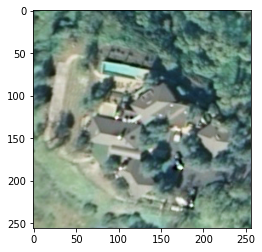

1882
BLEU-1 score: 75.79573059082031
BLEU-2 score: 66.51048278808594
BLEU-3 score: 58.95423889160156
BLEU-4 score: 54.061500549316406
Real Caption  1 : a house with orange roofs is surrounded by trees and cropland in the sparse residential area
Real Caption  2 : this is a sparse residential area with a house surrounded by trees and cropland
Real Caption  3 : a house with plants and cropland surrounded is in the sparse residential area
Real Caption  4 : a house with plants and cropland surrounded is in the sparse residential area
Real Caption  5 : a house with plants and cropland surrounded
Predicted Caption: a villa with plants surrounded is in the sparse residential area


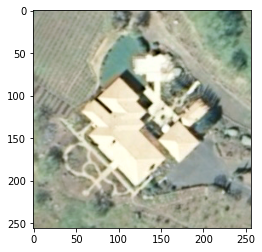

1883
BLEU-1 score: 76.67036437988281
BLEU-2 score: 66.9993896484375
BLEU-3 score: 54.87023162841797
BLEU-4 score: 42.86981964111328
Real Caption  1 : a house with orange roofs is surrounded by trees and cropland in the sparse residential area
Real Caption  2 : this is a sparse residential area with a house surrounded by trees and cropland
Real Caption  3 : a house with plants and cropland surrounded is in the sparse residential area
Real Caption  4 : a house with plants and cropland surrounded is in the sparse residential area
Real Caption  5 : a house with plants and cropland surrounded
Predicted Caption: a house is surrounded by verdant lawn in the sparse residential area


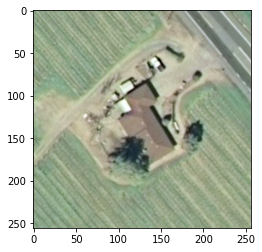

1884
BLEU-1 score: 75.79573059082031
BLEU-2 score: 66.51048278808594
BLEU-3 score: 58.95423889160156
BLEU-4 score: 54.061500549316406
Real Caption  1 : a house with orange roofs is surrounded by trees and cropland in the sparse residential area
Real Caption  2 : this is a sparse residential area with a house surrounded by trees and cropland
Real Caption  3 : a house with plants and cropland surrounded is in the sparse residential area
Real Caption  4 : a house with plants and cropland surrounded is in the sparse residential area
Real Caption  5 : a house with plants and cropland surrounded
Predicted Caption: a villa with plants surrounded is in the sparse residential area


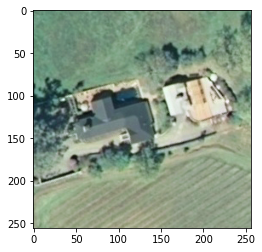

1885
BLEU-1 score: 85.71428680419922
BLEU-2 score: 81.19979858398438
BLEU-3 score: 76.0337142944336
BLEU-4 score: 69.9752197265625
Real Caption  1 : a house with orange roofs is surrounded by trees and cropland in the sparse residential area
Real Caption  2 : this is a sparse residential area with a house surrounded by trees and cropland
Real Caption  3 : a house with plants and cropland surrounded is in the sparse residential area
Real Caption  4 : a house with plants and cropland surrounded is in the sparse residential area
Real Caption  5 : a house with plants and cropland surrounded
Predicted Caption: this is a sparse residential area with a villa surrounded by trees and lawn


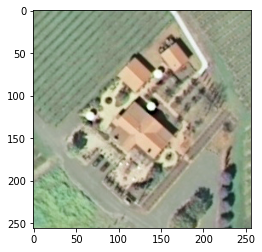

1886
BLEU-1 score: 66.66667175292969
BLEU-2 score: 53.452247619628906
BLEU-3 score: 44.464786529541016
BLEU-4 score: 34.791595458984375
Real Caption  1 : a house is surrounded by sands and bushes in the sparse residential area
Real Caption  2 : this is a sparse residential area with a house surrounded by sands and bushes
Real Caption  3 : a house with bushes surrounded is in the sparse residential area
Real Caption  4 : a house with bushes surrounded is in the sparse residential area
Real Caption  5 : a house with sands and bushes surrounded has some cars parked beside
Predicted Caption: a villa with grey roofs is surrounded by verdant lawn in the sparse residential area


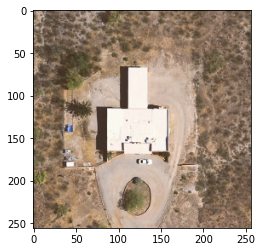

1887
BLEU-1 score: 81.81818389892578
BLEU-2 score: 70.06491088867188
BLEU-3 score: 64.84992980957031
BLEU-4 score: 60.76795959472656
Real Caption  1 : a house is surrounded by sands and bushes in the sparse residential area
Real Caption  2 : this is a sparse residential area with a house surrounded by sands and bushes
Real Caption  3 : a house with bushes surrounded is in the sparse residential area
Real Caption  4 : a house with bushes surrounded is in the sparse residential area
Real Caption  5 : a house with sands and bushes surrounded has some cars parked beside
Predicted Caption: a villa with plants surrounded is in the sparse residential area


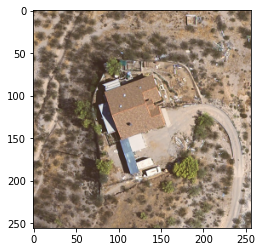

1888
BLEU-1 score: 83.33332824707031
BLEU-2 score: 77.84989166259766
BLEU-3 score: 71.3765869140625
BLEU-4 score: 63.404666900634766
Real Caption  1 : a house is surrounded by sands and bushes in the sparse residential area
Real Caption  2 : this is a sparse residential area with a house surrounded by sands and bushes
Real Caption  3 : a house with bushes surrounded is in the sparse residential area
Real Caption  4 : a house with bushes surrounded is in the sparse residential area
Real Caption  5 : a house with sands and bushes surrounded has some cars parked beside
Predicted Caption: a house is surrounded by verdant lawn in the sparse residential area


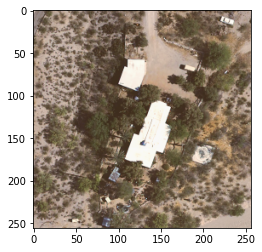

1889
BLEU-1 score: 84.61538696289062
BLEU-2 score: 75.10676574707031
BLEU-3 score: 67.5106430053711
BLEU-4 score: 59.2303352355957
Real Caption  1 : a house is surrounded by sands and bushes in the sparse residential area
Real Caption  2 : this is a sparse residential area with a house surrounded by sands and bushes
Real Caption  3 : a house with bushes surrounded is in the sparse residential area
Real Caption  4 : a house with bushes surrounded is in the sparse residential area
Real Caption  5 : a house with sands and bushes surrounded has some cars parked beside
Predicted Caption: a house is surrounded by trees and lawn in the sparse residential area


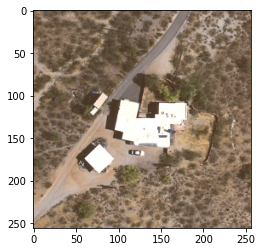

1890
BLEU-1 score: 78.35054779052734
BLEU-2 score: 65.05426025390625
BLEU-3 score: 52.2320671081543
BLEU-4 score: 40.30496597290039
Real Caption  1 : a house with is surrounded by bushes and snds in the sparse residential area
Real Caption  2 : this is a sparse residential area with a house surrounded by bushes and sands
Real Caption  3 : a house with white roofs has a swimming pool in the middle is in the sparse residential area
Real Caption  4 : a house with bushes surrounded is in the sparse residential area
Real Caption  5 : a house with bushes and sands surrounded has a swimming pool in the middle
Predicted Caption: a house is surrounded by trees and lawn in the sparse residential area


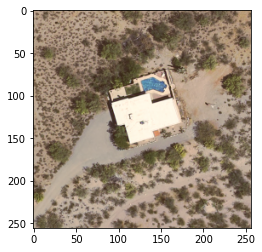

1981
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 90.36019897460938
Real Caption  1 : two small storage tanks are on the ground
Real Caption  2 : there are two small white storage tanks on the ground
Real Caption  3 : two small storage tanks are on the ground with a road beside
Real Caption  4 : there are two white storage tanks on the ground with a road beside
Real Caption  5 : two storage tanks are on the ground with a road beside
Predicted Caption: there are two small storage tanks on the ground


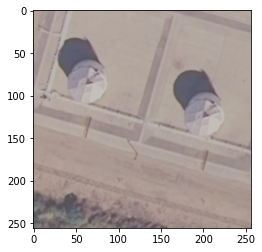

1982
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 97.40037536621094
Real Caption  1 : a small white storage tank is on the ground with a road beside
Real Caption  2 : there is one small storage tank on the ground with a road beside
Real Caption  3 : a small white storage tank is on the ground with a road beside
Real Caption  4 : there is a small white storage tank on the ground
Real Caption  5 : a small storage tank is on the ground with a road beside
Predicted Caption: there is a small storage tank on the ground with a road beside


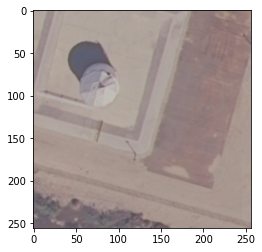

1983
BLEU-1 score: 83.33332824707031
BLEU-2 score: 77.84989166259766
BLEU-3 score: 75.14002990722656
BLEU-4 score: 72.92572021484375
Real Caption  1 : a storage tank with some houses and plants beside
Real Caption  2 : there is one storage tank in the lawn with a highway beside
Real Caption  3 : a storage tank is in the lawn with some buildings and a highway beside
Real Caption  4 : there is a white storage tank on the lawn with some buildings and a highway beside
Real Caption  5 : a storage tank is on the lawn and some buildings beside
Predicted Caption: a storage tank is on the lawn and some cars parked beside


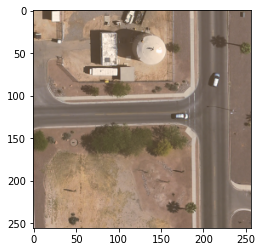

1984
BLEU-1 score: 88.8888931274414
BLEU-2 score: 88.19171142578125
BLEU-3 score: 87.35804748535156
BLEU-4 score: 86.33399963378906
Real Caption  1 : a storage tank with a highway beside
Real Caption  2 : there is one storage tank on the sands with a highway beside
Real Caption  3 : a storage tank is on the sands with a highway beside
Real Caption  4 : there is a white storage tank on the sands with a highway beside
Real Caption  5 : a storage tank is on the sands with a highway beside
Predicted Caption: there is a white storage tank on the ground


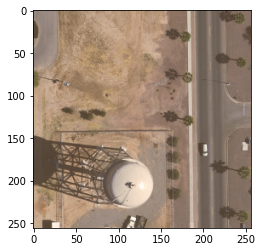

1985
BLEU-1 score: 76.92308044433594
BLEU-2 score: 62.01736831665039
BLEU-3 score: 47.161224365234375
BLEU-4 score: 32.00286102294922
Real Caption  1 : a storage tank with a highway beside
Real Caption  2 : there is one storage tank on the sands with a highway beside
Real Caption  3 : a storage tank is on the sands with a highway beside
Real Caption  4 : there is a white storage tank on the sands with a highway beside
Real Caption  5 : a storage tank is on the sands with a highway beside
Predicted Caption: there is a small storage tank on the ground with a road beside


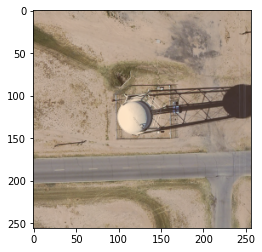

1986
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : a big storage tank is on the ground
Real Caption  2 : there is one big storage tank on the ground
Real Caption  3 : a big storage tank is on the ground
Real Caption  4 : there is a white storage tank on the ground
Real Caption  5 : a big storage tank is on the ground
Predicted Caption: there is a white storage tank on the ground


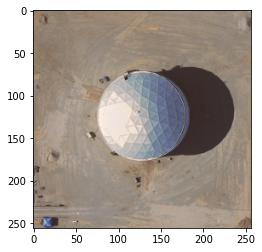

1987
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : a big storage tank is on the ground
Real Caption  2 : there is one big storage tank on the ground
Real Caption  3 : a big storage tank is on the ground
Real Caption  4 : there is a white storage tank on the ground
Real Caption  5 : a big storage tank is on the ground
Predicted Caption: there is a white storage tank on the ground


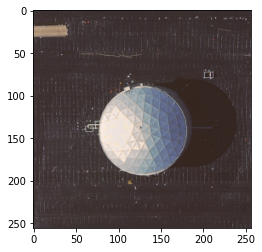

1988
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : a big storage tank is on the ground
Real Caption  2 : there is one big storage tank on the ground
Real Caption  3 : a big storage tank is on the ground
Real Caption  4 : there is a white storage tank on the ground
Real Caption  5 : a big storage tank is on the ground
Predicted Caption: there is a white storage tank on the ground


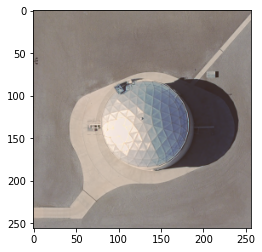

1989
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 94.99142456054688
BLEU-4 score: 80.9106674194336
Real Caption  1 : a small storage tank is on the ground
Real Caption  2 : there is one storage tank on the ground and some buildings beside
Real Caption  3 : a storage tank is on the ground and some buildings beside
Real Caption  4 : there is a white storage tank on the ground
Real Caption  5 : a storage tank is on the ground and some buildings beside
Predicted Caption: there is a small storage tank on the ground


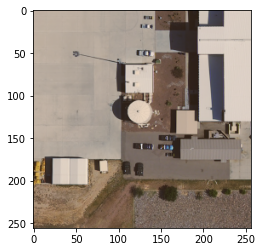

1990
BLEU-1 score: 72.38699340820312
BLEU-2 score: 66.0799789428711
BLEU-3 score: 52.91521453857422
BLEU-4 score: 0.0
Real Caption  1 : a small storage tank is on the ground
Real Caption  2 : there is one storage tank on the ground and some buildings beside
Real Caption  3 : a storage tank is on the ground and some buildings beside
Real Caption  4 : there is a white storage tank on the ground
Real Caption  5 : a storage tank is on the ground and some buildings beside
Predicted Caption: there is a small storage tanks are on the ground


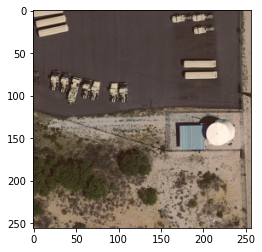

2081
BLEU-1 score: 91.66667175292969
BLEU-2 score: 86.6025390625
BLEU-3 score: 80.67143249511719
BLEU-4 score: 76.91605377197266
Real Caption  1 : three tennis courts arranged neatly with some plants surrounded
Real Caption  2 : three tennis courts are surrounded by some trees and some cars parked beside
Real Caption  3 : there are three tennis courts surrounded by some plants with some cars parked beside
Real Caption  4 : there are three tennis courts surrounded by some trees with some cars parked beside
Real Caption  5 : there are three tennis courts arranged neatly and surrounded by some plants
Predicted Caption: there are two tennis courts arranged neatly and surrounded by some plants


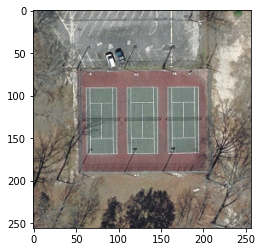

2082
BLEU-1 score: 91.66667175292969
BLEU-2 score: 86.6025390625
BLEU-3 score: 80.67143249511719
BLEU-4 score: 73.4888916015625
Real Caption  1 : four tennis courts arranged neatly with some plants and lawn surrounded
Real Caption  2 : four tennis courts are surrounded by some trees and lawn
Real Caption  3 : there are four tennis courts arranged in lines and surrounded by some plants and lawn
Real Caption  4 : there are four tennis courts surrounded by some trees and lawn
Real Caption  5 : there are four tennis courts arranged in lines and surrounded by lawn
Predicted Caption: there are four tennis courts arranged neatly and surrounded by some buildings


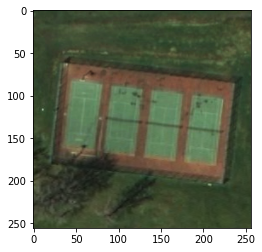

2083
BLEU-1 score: 56.4321174621582
BLEU-2 score: 36.0941047668457
BLEU-3 score: 22.258541107177734
BLEU-4 score: 0.0
Real Caption  1 : a tennis court next to a basketball court with some plants and buildings beside
Real Caption  2 : a tennis court next to a basketball court are surrounded by some trees and some cars parked beside
Real Caption  3 : there is a small tennis court next to a basketball court with some buildings and plants beside
Real Caption  4 : there is a tennis court next to a basketball court surrounded by some trees and some cars parked beside
Real Caption  5 : there is a small tennis court next to a basketball court surrounded by some plants and some cars parked beside
Predicted Caption: there are two tennis courts arranged neatly and surrounded by some buildings


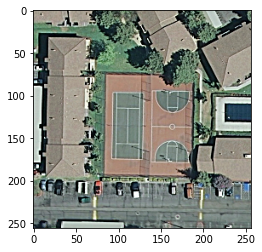

2084
BLEU-1 score: 100.0
BLEU-2 score: 95.34626007080078
BLEU-3 score: 93.52978515625
BLEU-4 score: 92.34732055664062
Real Caption  1 : two tennis courts arranged neatly with some plants surrounded
Real Caption  2 : two tennis courts are surrounded by some trees and buildings
Real Caption  3 : there are two tennis courts surrounded by some plants and buildings
Real Caption  4 : there are two tennis courts surrounded by some trees and buildings
Real Caption  5 : there are two tennis courts arranged neatly and surrounded by some plants and buildings
Predicted Caption: there are two tennis courts arranged neatly and surrounded by some buildings


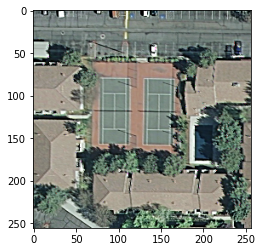

2085
BLEU-1 score: 100.0
BLEU-2 score: 95.34626007080078
BLEU-3 score: 93.52978515625
BLEU-4 score: 92.34732055664062
Real Caption  1 : two tennis courts arranged neatly with some plants surrounded
Real Caption  2 : two tennis courts are surrounded by some trees and buildings
Real Caption  3 : there are two tennis courts surrounded by some plants and buildings
Real Caption  4 : there are two tennis courts surrounded by some trees and buildings
Real Caption  5 : there are two tennis courts arranged neatly and surrounded by some plants and buildings
Predicted Caption: there are two tennis courts arranged neatly and surrounded by some buildings


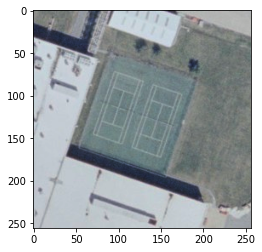

2086
BLEU-1 score: 58.33333206176758
BLEU-2 score: 56.40760803222656
BLEU-3 score: 54.18533706665039
BLEU-4 score: 51.56626892089844
Real Caption  1 : four tennis courts arranged neatly on the lawn
Real Caption  2 : four tennis courts are arranged in line on the lawn
Real Caption  3 : there are four tennis courts arranged in line on the lawn
Real Caption  4 : there are four tennis courts arranged in line on the lawn
Real Caption  5 : there are four tennis courts arranged neatly on the lawn
Predicted Caption: there are four tennis courts arranged neatly and surrounded by some plants


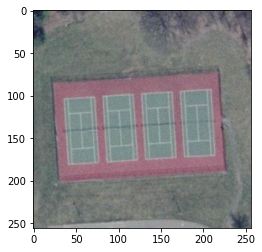

2087
BLEU-1 score: 100.0
BLEU-2 score: 100.0
BLEU-3 score: 100.0
BLEU-4 score: 100.0
Real Caption  1 : two tennis courts arranged neatly with some plants surrounded
Real Caption  2 : two tennis courts are surrounded by some trees and a road beside
Real Caption  3 : there are two tennis courts surrounded by some plants with a road beside
Real Caption  4 : there are two tennis courts surrounded by some trees with buildings
Real Caption  5 : there are two tennis courts arranged neatly and surrounded by some plants
Predicted Caption: there are two tennis courts arranged neatly and surrounded by some plants


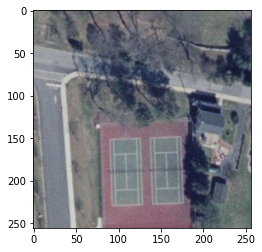

2088
BLEU-1 score: 91.66667175292969
BLEU-2 score: 91.28709411621094
BLEU-3 score: 90.85602569580078
BLEU-4 score: 90.36019897460938
Real Caption  1 : four tennis courts arranged neatly with some plants surrounded
Real Caption  2 : four tennis courts are surrounded by some plants and a road beside
Real Caption  3 : there are four tennis courts surrounded by some plants with a road beside
Real Caption  4 : there are four tennis courts surrounded by some plants with a road beside
Real Caption  5 : there are four tennis courts arranged neatly and surrounded by some plants
Predicted Caption: there are four tennis courts arranged neatly and surrounded by some buildings


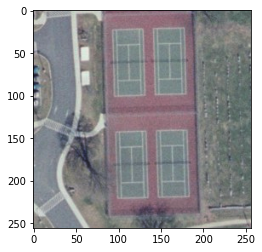

2089
BLEU-1 score: 66.66667175292969
BLEU-2 score: 60.302268981933594
BLEU-3 score: 56.651634216308594
BLEU-4 score: 53.31675338745117
Real Caption  1 : four tennis courts arranged neatly on the lawn with some trees beside
Real Caption  2 : four tennis courts are arranged in line on the lawn with some trees beside
Real Caption  3 : there are four tennis courts arranged in line on the lawn
Real Caption  4 : there are four tennis courts arranged in line on the lawn
Real Caption  5 : there are four tennis courts arranged neatly on the lawn with some trees beside
Predicted Caption: there are four tennis courts arranged neatly and surrounded by some plants


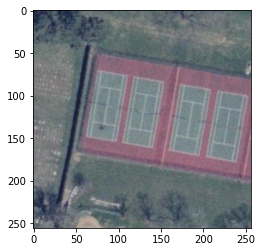

2090
BLEU-1 score: 66.66667175292969
BLEU-2 score: 60.302268981933594
BLEU-3 score: 56.651634216308594
BLEU-4 score: 53.31675338745117
Real Caption  1 : two tennis courts arranged neatly on the lawn with some trees beside
Real Caption  2 : two tennis courts are arranged in line on the lawn with some trees beside
Real Caption  3 : there are two tennis courts arranged in line on the lawn
Real Caption  4 : there are two tennis courts arranged in line on the lawn
Real Caption  5 : there are two tennis courts arranged neatly on the lawn with some trees beside
Predicted Caption: there are two tennis courts arranged neatly and surrounded by some plants


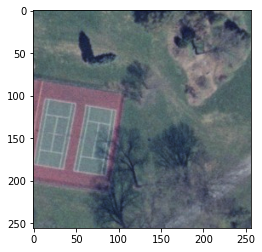

In [27]:
import matplotlib.pyplot as plt
rid = np.random.randint(0, len(val_dict.keys()))
for rid in range(  len(list(val_dict.keys()))):
    nb = list(val_dict.keys())[rid]
    print(nb)
    score1,score2,score3,score4,references,candidate=evaluate_bleu_img(transformer,nb,val_dict)
    print(f"BLEU-1 score: {score1*100}")
    print(f"BLEU-2 score: {score2*100}")
    print(f"BLEU-3 score: {score3*100}")
    print(f"BLEU-4 score: {score4*100}")
    for c in range(len(references[0])):
      print('Real Caption ',c+1,':',' '.join(references[0][c]))
    print ('Predicted Caption:', ' '.join(candidate[0]))
    image=image_path+str(nb)+'.tif'
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.pause(0.001)

In [28]:
transformer.load_state_dict(torch.load("best_transformer"))
import matplotlib.pyplot as plt
rid = np.random.randint(0, len(test_dict.keys()))
nb = list(test_dict.keys())[rid]
print(nb)
score1,score2,score3,score4,references,candidate=evaluate_bleu_img(transformer,nb,test_dict)
print(f"BLEU-1 score: {score1*100}")
print(f"BLEU-2 score: {score2*100}")
print(f"BLEU-3 score: {score3*100}")
print(f"BLEU-4 score: {score4*100}")
for c in range(len(references[0])):
  print('Real Caption ',c+1,':',' '.join(references[0][c]))
print ('Predicted Caption:', ' '.join(candidate[0]))
image=image_path_AB+str(nb)+'.png'
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)

1095
BLEU-1 score: 84.33740234375
BLEU-2 score: 79.67817687988281
BLEU-3 score: 74.22129821777344
BLEU-4 score: 67.61304473876953
Real Caption  1 : lots of boats docked at the harbor and the water is deep blue
Real Caption  2 : lots of boats docked neatly at the harbor
Real Caption  3 : many boats docked neatly at the harbor and the water is deep blue
Real Caption  4 : many boats docked neatly at the harbor and only a few positions are free
Real Caption  5 : lots of boats docked neatly at the harbor and only a few positions are free
Predicted Caption: many boats docked neatly at the harbor and some positions are free


NameError: name 'image_path_AB' is not defined